# Analyse and plot the different projections (relative to temperature targets ...)

In [8]:
import pandas as pd
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
import matplotlib
import seaborn as sns

matplotlib.rcParams['figure.figsize'] = (14, 8)

In [9]:
# IPCC colors from: https://pyam-iamc.readthedocs.io/en/stable/tutorials/ipcc_colors.html
colors_scenario = {# AR6 ssps (from CMIP6)
                    'ssp119':'#00a9cf', 'ssp126': '#003466',
                   'ssp245':'#f69320', 'ssp370':'#df0000',
                   'ssp434':'#2274ae',
                  'ssp460': '#b0724e', 'ssp534-over':'#92397a',
                  'ssp585':'#980002',
                   # AR5 rcp colors
                  #'rcp26': '#0000FF', 'rcp45':'#79BCFF', 'rcp60':'#FF822D', 'rcp85':'#FF0000',
                  # AR6 rcp colors
                  'rcp26': '#003466', 'rcp45':'#709fcc', 'rcp60':'#c37900', 'rcp85':'#980002'}

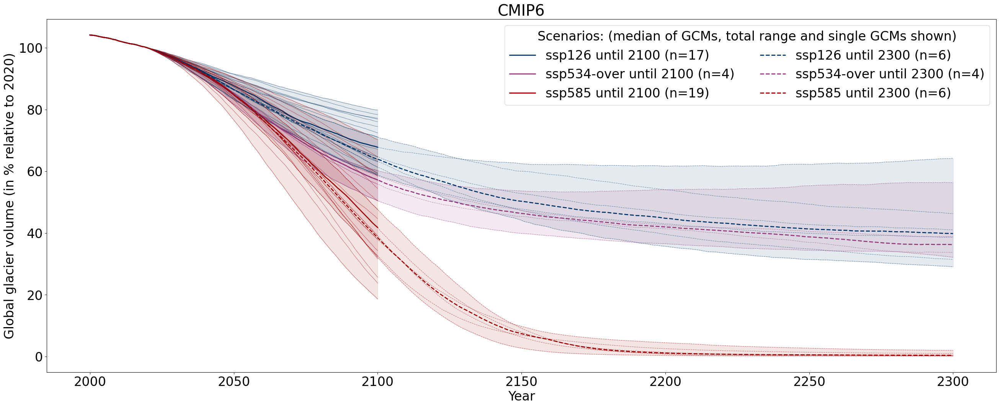

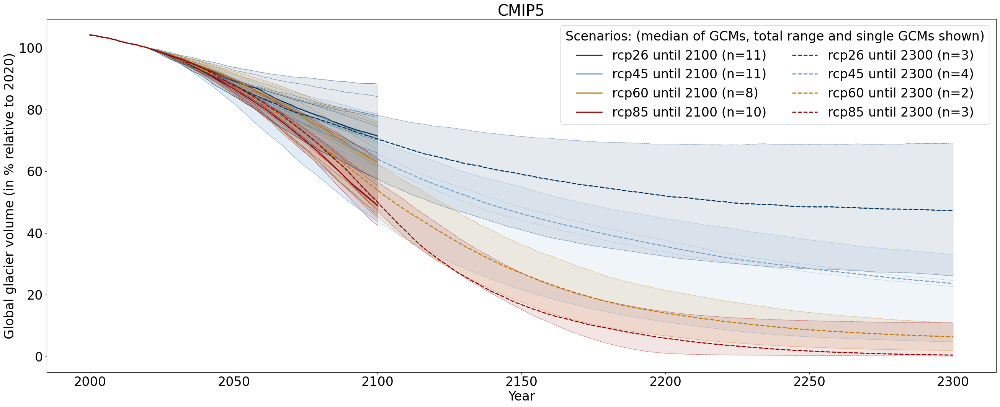

In [10]:
# change this path to your local path 
path = '/home/lilianschuster/oggm-standard-projections-csv-files/1.6.1/'
df_meta = pd.read_csv(f'{path}/common_running_2100_2300/metadata.csv')
df_rel_2300 = pd.DataFrame(columns = df_meta.gcm.unique())

plt.rc('font', size=24)
end_year= 2100
ls_d = {2100:'-', 2300:'--'}
plt.figure(figsize=(32,12)) #harey=True, sharex=True)
for j,cmip in enumerate(['CMIP6']):
    ax = plt.gca()
    for end_year in [2100,2300]:
        ls = ls_d[end_year]
        # let's only plot those scenarios that exist only until 2300
        scenario_list = list(df_meta.loc[(df_meta.cmip==cmip) & (df_meta.end_year==2300)].scenario.unique())
        scenario_list.sort()
        for scenario in scenario_list:
            idir = path + 'common_running_2100_2300/' + f'volume/{cmip}/{end_year}/global/'

            df = pd.read_csv(idir + f'{scenario}.csv', index_col=0)
            df_rel = 100*df/df.loc[2020]

            ax.plot(df.index, df_rel.median(axis=1), lw=2, color=colors_scenario[scenario],
                    label = f'{scenario} until {end_year} (n={len(df_rel.columns)})', ls= ls_d[end_year])
            ax.plot(df.index, df_rel, lw=0.8, alpha = 0.5, color=colors_scenario[scenario],
                   ls= ls_d[end_year]);
            ax.fill_between(df.index, df_rel.min(axis=1), df_rel.max(axis=1), alpha=0.1, color=colors_scenario[scenario])

            ax.set_ylabel('Global glacier volume (in % relative to 2020)')
            ax.set_xlabel('Year')
            if end_year == 2300:
                df_rel_2300.loc[f'{cmip}\n{scenario}:\nn={len(df_rel.columns)}', df_rel.columns] = df_rel.loc[2299]
        #if end_year == 2100:
    plt.legend(title='Scenarios: (median of GCMs, total range and single GCMs shown)', ncol=2);

    ax.set_title(cmip)
    #plt.savefig('global_glacier_volume_until2300_common_running_2100_2300_cmip6.png')

plt.rc('font', size=24)
end_year= 2100
ls_d = {2100:'-', 2300:'--'}
plt.figure(figsize=(32,12)) #harey=True, sharex=True)
for j,cmip in enumerate(['CMIP5']):
    ax = plt.gca()
    for end_year in [2100,2300]:
        ls = ls_d[end_year]
        # let's only plot those scenarios that exist only until 2300
        scenario_list = list(df_meta.loc[(df_meta.cmip==cmip) & (df_meta.end_year==2300)].scenario.unique())
        scenario_list.sort()
        for scenario in scenario_list:
            idir = path + 'common_running_2100_2300/' + f'volume/{cmip}/{end_year}/global/'

            df = pd.read_csv(idir + f'{scenario}.csv', index_col=0)
            df_rel = 100*df/df.loc[2020]

            ax.plot(df.index, df_rel.median(axis=1), lw=2, color=colors_scenario[scenario],
                    label = f'{scenario} until {end_year} (n={len(df_rel.columns)})', ls= ls_d[end_year])
            ax.plot(df.index, df_rel, lw=0.8, alpha = 0.5, color=colors_scenario[scenario],
                   ls= ls_d[end_year]);
            ax.fill_between(df.index, df_rel.min(axis=1), df_rel.max(axis=1), alpha=0.1, color=colors_scenario[scenario])

            ax.set_ylabel('Global glacier volume (in % relative to 2020)')
            ax.set_xlabel('Year')
            if end_year == 2300:
                df_rel_2300.loc[f'{cmip}\n{scenario}:\nn={len(df_rel.columns)}', df_rel.columns] = df_rel.loc[2299]
        #if end_year == 2100:
    plt.legend(title='Scenarios: (median of GCMs, total range and single GCMs shown)', ncol=2);

    ax.set_title(cmip)
    #plt.savefig('global_glacier_volume_until2300_common_running_2100_2300_cmip5.png')

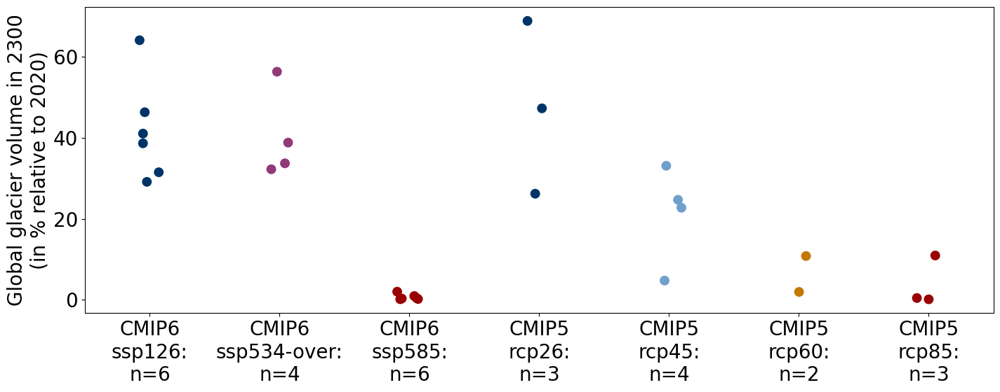

In [11]:
colors_s = []
for s in df_rel_2300.index:
    colors_s.append(colors_scenario[s[6:-5]])

plt.figure(figsize=(14,6))
plt.rc('font', size=20)

#sns.boxplot(df_rel_2300.dropna(how='all', axis=1).T, saturation = 0.1,
#            color='grey', whis=0,fliersize=0)
sns.stripplot(df_rel_2300.dropna(how='all', axis=1).T, color='grey',
              palette = colors_s,
              alpha = 1, size=10)

plt.tight_layout()
plt.ylabel('Global glacier volume in 2300\n(in % relative to 2020)');

## Regional plots

In [12]:
d_reg_num_name = {}
d_reg_num_name['global'] = 'Global'
d_reg_num_name['01'] = 'Alaska'
d_reg_num_name['02'] = 'Western Canada & USA'
d_reg_num_name['03'] = 'Arctic Canada North'
d_reg_num_name['04'] = 'Arctic Canada South'
d_reg_num_name['05'] = 'Greenland'
d_reg_num_name['06'] = 'Iceland'
d_reg_num_name['07'] = 'Svalbard and Jan Mayen'
d_reg_num_name['08'] = 'Scandinavia'
d_reg_num_name['09'] = 'Russian Arctic'
d_reg_num_name['10'] = 'North Asia'
d_reg_num_name['11'] = 'Central Europe'
d_reg_num_name['12'] = 'Caucasus and Middle East'
d_reg_num_name['13'] = 'Central Asia'
d_reg_num_name['14'] = 'South Asia West'
d_reg_num_name['15'] = 'South Asia East'
d_reg_num_name['16'] = 'Low Latitudes'
d_reg_num_name['17'] = 'Southern Andes'
d_reg_num_name['18'] = 'New Zealand'
d_reg_num_name['19'] = 'Antarctic and Subantarctic'

d_reg_num_name_icci = {}
d_reg_num_name_icci_reg = {'low-latitudes':['16'], 'mid-latitudes':['08', '11','02','18'], 'polar-hma':['06','13-14-15','01','04','17']}
d_reg_num_name_icci['global'] = 'Glaciers globally'
d_reg_num_name_icci['01'] = 'Glaciers of Alaska'
d_reg_num_name_icci['02'] = 'Glaciers of Western Canada & US'
d_reg_num_name_icci['03'] = 'Glaciers of Arctic Canada (North)'
d_reg_num_name_icci['04'] = 'Glaciers of Arctic Canada (South)'
d_reg_num_name_icci['05'] = 'Glaciers of Greenland'
d_reg_num_name_icci['06'] = 'Glaciers of Iceland'
d_reg_num_name_icci['07'] = 'Glaciers of Svalbard and Jan Mayen'
d_reg_num_name_icci['08'] = 'Glaciers of Scandinavia'
d_reg_num_name_icci['09'] = 'Glaciers of Russian Arctic'
d_reg_num_name_icci['10'] = 'Glaciers of North Asia'
d_reg_num_name_icci['11'] = 'Glaciers of the Alps'
d_reg_num_name_icci['12'] = 'Glaciers of Caucasus and Middle East'
d_reg_num_name_icci['13'] = 'Glaciers of Central Asia'
d_reg_num_name_icci['13-14-15'] = 'Glaciers of High Mountain Asia'
d_reg_num_name_icci['14'] = 'Glaciers of South Asia West'
d_reg_num_name_icci['15'] = 'Glaciers of South Asia East'
d_reg_num_name_icci['16'] = 'Tropical Glaciers'
d_reg_num_name_icci['17'] = 'Glaciers of Patagonia & Southern Andes'
d_reg_num_name_icci['18'] = 'Glaciers of New Zealand'
d_reg_num_name_icci['19'] = 'Glaciers of Antarctic and Subantarctic'

## Plots relative to temperature changes

In [15]:
# pd_temp_ch_2100_2300_cmip5 = pd.read_csv('Global_mean_temp_deviation_2081_2100_2281_2300_rel_1850_1900_cmip5_gcms.csv', index_col=0)
# need to check which interpolation to choose, .... 
import oggm
_file_cmip5 = oggm.utils.file_downloader('https://cluster.klima.uni-bremen.de/~oggm/oggm-standard-projections/analysis_notebooks/Global_mean_temp_deviation_2081_2100_2281_2300_rel_1850_1900_cmip5_gcms.csv', reset=True)
_file_cmip6 = oggm.utils.file_downloader('https://cluster.klima.uni-bremen.de/~oggm/oggm-standard-projections/analysis_notebooks/Global_mean_temp_deviation_2081_2100_2281_2300_rel_1850_1900_cmip6_gcms.csv', reset=True)
pd_cmip5_temp_ch_2100 = pd.read_csv(_file_cmip5, index_col=0)
pd_cmip6_temp_ch_2100 = pd.read_csv(_file_cmip6, index_col=0)
path = '/home/lilianschuster/oggm-standard-projections-csv-files/1.6.1'
df_rel_2300 = pd.DataFrame(columns = df_meta.gcm.unique())

/home/lilianschuster/anaconda3/envs/oggm_v16/lib/python3.11/site-packages/pyproj/__init__.py:89: UserWarning: pyproj unable to set database path.
  _pyproj_global_context_initialize()


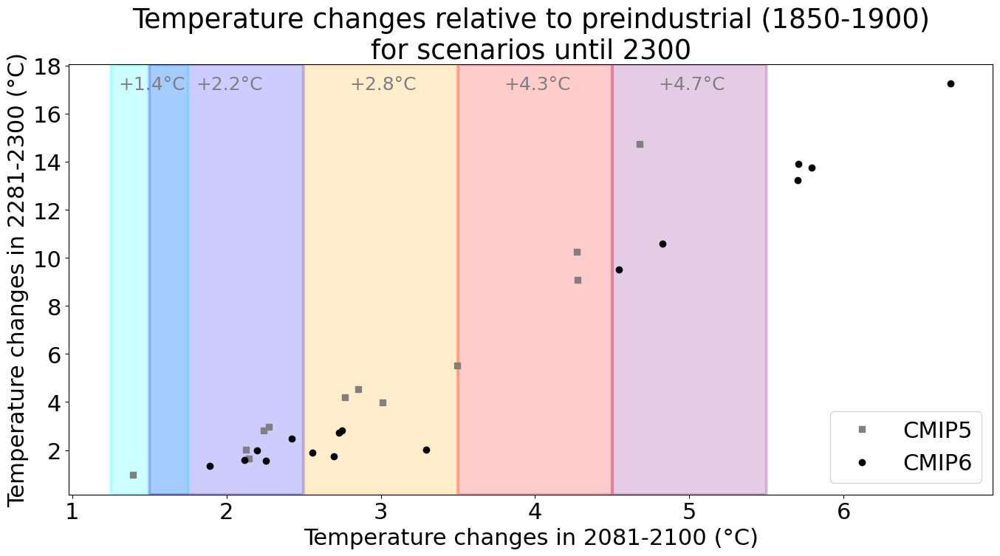

In [29]:
colors_temp= {'+1.5°C':'cyan', '+2.0°C':'blue', '+3.0°C':'orange', '+4.0°C':'red', '+5.0°C':'purple'}

pd_cmip_temp_ch_2100 = pd.concat([pd_cmip6_temp_ch_2100, pd_cmip5_temp_ch_2100])
pd_cmip_temp_ch_2100 = pd_cmip_temp_ch_2100.loc[pd_cmip_temp_ch_2100.ssp != 'ssp534-over']
index_2300 = pd_cmip_temp_ch_2100['global_temp_ch_2281-2300_preindustrial'].dropna().index
temp_lev_reality = {}
for temp_lev in colors_temp.keys():
    _t = pd_cmip_temp_ch_2100.loc[pd_cmip_temp_ch_2100.loc[index_2300,
                                                            f'global_temp_ch_level_2081-2100_preindustrial_{temp_lev}'].dropna().index,
                                  'global_temp_ch_2081-2100_preindustrial'].median().round(1)
    temp_lev_reality[temp_lev] = f'+{_t}°C'
    
plt.plot(pd_cmip5_temp_ch_2100['global_temp_ch_2081-2100_preindustrial'], pd_cmip5_temp_ch_2100['global_temp_ch_2281-2300_preindustrial'],
         's', label='CMIP5', color='grey')
plt.ylabel('global_temp_ch_2281-2300_preindustrial')
plt.xlabel('global_temp_ch_2081-2100_preindustrial')
plt.gca().axvspan(1.25, 1.75, color='cyan', alpha = 0.2,lw=3)
plt.gca().axvspan(1.5, 2.5, color='blue', alpha = 0.2,lw=3)
plt.gca().axvspan(2.5, 3.5, color='orange', alpha = 0.2,lw=3)
plt.gca().axvspan(3.5, 4.5, color='red', alpha = 0.2,lw=3)
plt.gca().axvspan(4.5, 5.5, color='purple', alpha = 0.2,lw=3)


plt.plot(pd_cmip6_temp_ch_2100['global_temp_ch_2081-2100_preindustrial'], pd_cmip6_temp_ch_2100['global_temp_ch_2281-2300_preindustrial'],
         'o', label='CMIP6', color='black')
plt.ylabel('Temperature changes in 2281-2300 (°C)')
plt.xlabel('Temperature changes in 2081-2100 (°C)')
plt.title('Temperature changes relative to preindustrial (1850-1900)\nfor scenarios until 2300')
plt.legend()
plt.tight_layout()
plt.savefig('overview_temperature_levels.png')
for k in temp_lev_reality.keys():
    plt.text(float(k[1:4])-0.2, 17, f'{k}\n realitiy: temp_lev_reality[k], color='grey', fontsize=18)

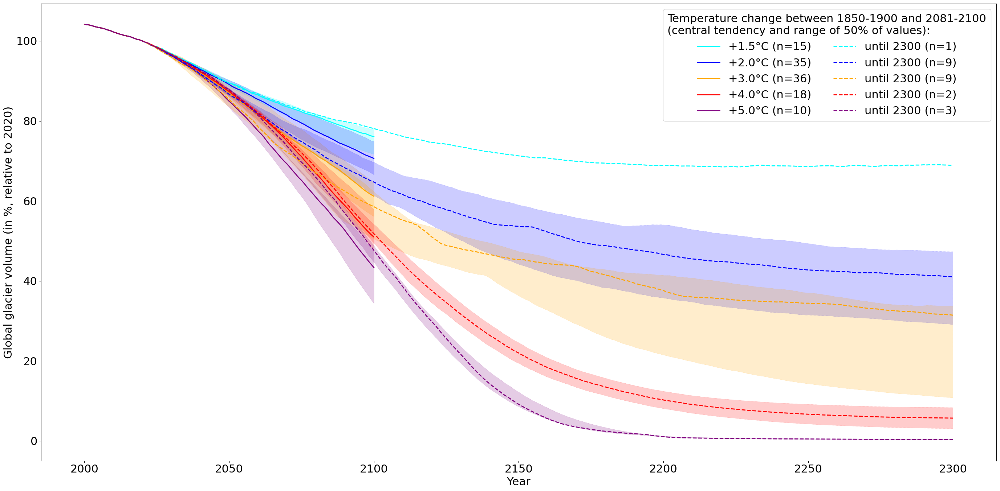

In [19]:

plt.figure(figsize=(28,14)) #harey=True, sharex=True)

plt.rc('font', size=22)
ax = plt.gca()
for end_year,ls in zip(['2100', '2300'], ['-','--']):
    for temp_lev in colors_temp.keys():
        df_rel_l = []

        for cmip,pd_cmip in zip(['CMIP5','CMIP6'], [pd_cmip5_temp_ch_2100, pd_cmip6_temp_ch_2100]):
            for gcm_scenario in pd_cmip[f'global_temp_ch_level_2081-2100_preindustrial_{temp_lev}'].dropna().index:
                try:
                    gcm, scenario = gcm_scenario.split('_')
                    n = len(gcm_scenario)
                    idir = path + '/common_running_2100_2300/' + f'volume/{cmip}/{end_year}/global/'
                    df = pd.read_csv(idir + f'{scenario}.csv', index_col=0)
                    df = df[gcm.upper()]
                    df_rel = 100*df/df.loc[2020]
                    df_rel_l.append(df_rel)
                except:
                    pass
        if len(df_rel_l) > 0:
            df_rel_med = pd.DataFrame(df_rel_l).T.median(axis=1)
            if end_year == '2100':
                label = f'{temp_lev} (n={len(df_rel_l)})'
            else:
                label = f'until 2300 (n={len(df_rel_l)})'
            ax.plot(df.index, df_rel_med, lw=2, color=colors_temp[temp_lev],
                                label = label, ls=ls)

            df_rel_q25 = pd.DataFrame(df_rel_l).T.quantile(0.25, axis=1)
            df_rel_q75 = pd.DataFrame(df_rel_l).T.quantile(0.75, axis=1)
            ax.fill_between(df.index, df_rel_q25, df_rel_q75, lw=0.5, alpha=0.2, 
                                color=colors_temp[temp_lev],
                                    ls = ls)

plt.ylabel('Global glacier volume (in %, relative to 2020)')
plt.xlabel('Year')
plt.legend(title='Temperature change between 1850-1900 and 2081-2100\n(central tendency and range of 50% of values):', ncol=2)
plt.tight_layout()
plt.savefig('first_trial_only_oggm.png')

## OLD (relative to emission scenarios...)

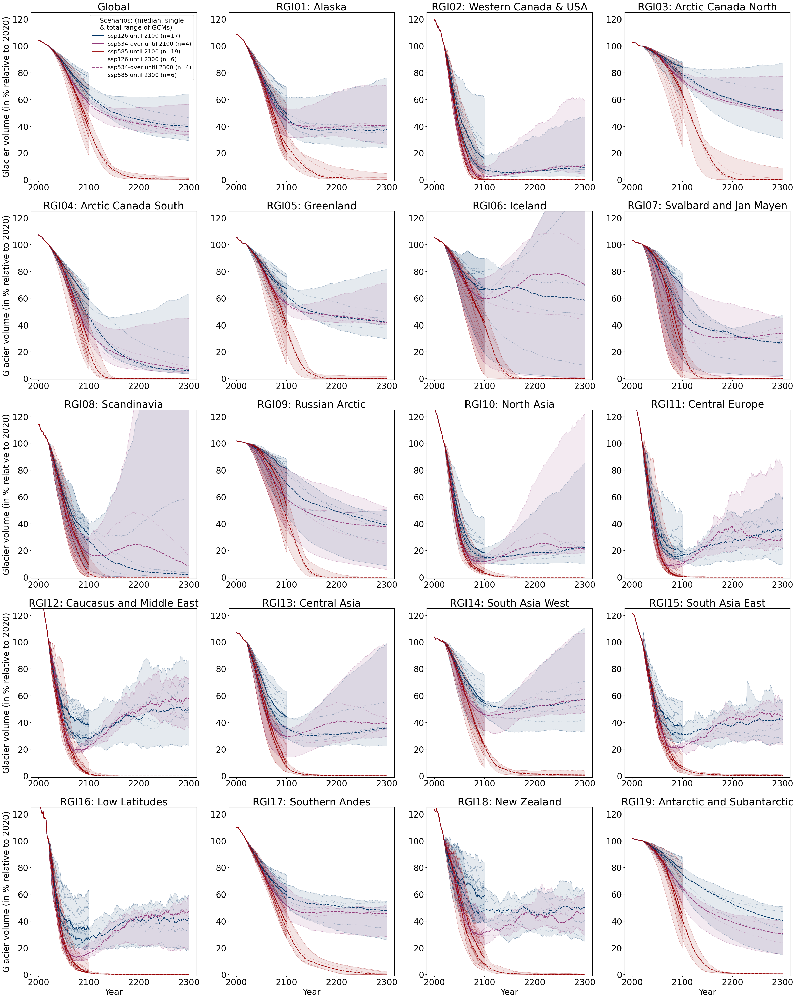

In [110]:
df_meta = pd.read_csv(f'{path}/common_running_2100_2300/metadata.csv')
end_year= 2100
ls_d = {2100:'-', 2300:'--'}
cmip = 'CMIP6'
plt.rc('font', size=24)
plt.figure(figsize=(32,40)) #harey=True, sharex=True)
#plt.ylabel('Volume (in % relative to 2020)')

for j,r in enumerate(['Global', 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19]):
    plt.subplot(5,4,j+1)
    ax = plt.gca()

    if r == 'Global':
        rgi_reg = r
        rgi_reg_l = 'global'
        ax.set_title('Global')
    else:
        rgi_reg = f'{r:02}'
        rgi_reg_l = f'RGI{rgi_reg}'
        ax.set_title(f'{rgi_reg_l}: {d_reg_num_name[rgi_reg]}')
        
    for end_year in [2100,2300]:
        ls = ls_d[end_year]
        # let's only plot those scenarios that exist only until 2300
        scenario_list = list(df_meta.loc[(df_meta.cmip==cmip) & (df_meta.end_year==2300)].scenario.unique())
        scenario_list.sort()
        for scenario in scenario_list:
            idir = path + 'common_running_2100_2300/' + f'volume/{cmip}/{end_year}/{rgi_reg_l}/'

            df = pd.read_csv(idir + f'{scenario}.csv', index_col=0)
            df_rel = 100*df/df.loc[2020]

            ax.plot(df.index, df_rel.median(axis=1), lw=2, color=colors_scenario[scenario],
                    label = f'{scenario} until {end_year} (n={len(df_rel.columns)})', ls= ls_d[end_year])
            ax.plot(df.index, df_rel, lw=0.5, alpha = 0.5, color=colors_scenario[scenario],
                   ls= ls_d[end_year]);
            ax.fill_between(df.index, df_rel.min(axis=1), df_rel.max(axis=1), alpha=0.1, color=colors_scenario[scenario])
    if j in [0,4,8,12,16]:
        ax.set_ylabel('Glacier volume (in % relative to 2020)')
    if j>=16:
        ax.set_xlabel('Year')
    if j == 0:
        ax.legend(title='Scenarios: (median, single\n& total range of GCMs)', ncol=1, fontsize=16, title_fontsize=18, loc = 'upper right');
    ax.set_ylim([-1,125])
plt.tight_layout()
plt.savefig('regional_glacier_volume_until2300_common_running_2100_2300_cmip6.png')

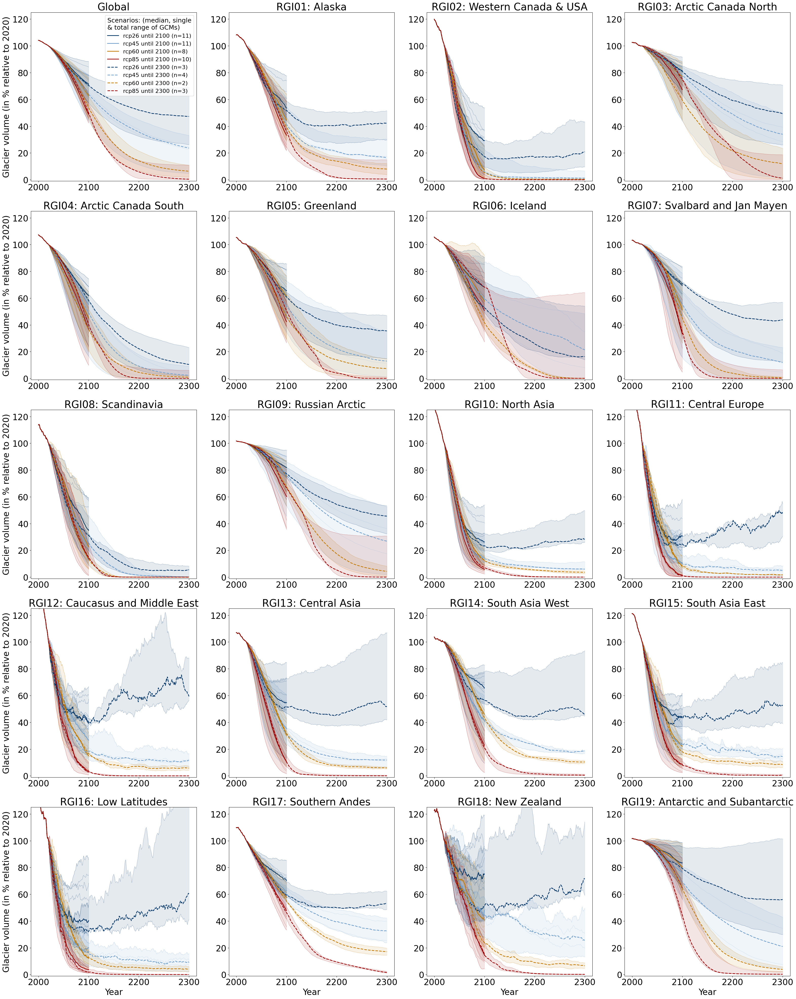

In [111]:
df_meta = pd.read_csv(f'{path}/common_running_2100_2300/metadata.csv')
end_year= 2100
ls_d = {2100:'-', 2300:'--'}
cmip = 'CMIP5'
plt.rc('font', size=24)
plt.figure(figsize=(32,40)) #harey=True, sharex=True)
#plt.ylabel('Volume (in % relative to 2020)')

for j,r in enumerate(['Global', 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19]):
    plt.subplot(5,4,j+1)
    ax = plt.gca()

    if r == 'Global':
        rgi_reg = r
        rgi_reg_l = 'global'
        ax.set_title('Global')
    else:
        rgi_reg = f'{r:02}'
        rgi_reg_l = f'RGI{rgi_reg}'
        ax.set_title(f'{rgi_reg_l}: {d_reg_num_name[rgi_reg]}')
        
    for end_year in [2100,2300]:
        ls = ls_d[end_year]
        # let's only plot those scenarios that exist only until 2300
        scenario_list = list(df_meta.loc[(df_meta.cmip==cmip) & (df_meta.end_year==2300)].scenario.unique())
        scenario_list.sort()
        for scenario in scenario_list:
            idir = path + 'common_running_2100_2300/' + f'volume/{cmip}/{end_year}/{rgi_reg_l}/'

            df = pd.read_csv(idir + f'{scenario}.csv', index_col=0)
            df_rel = 100*df/df.loc[2020]

            ax.plot(df.index, df_rel.median(axis=1), lw=2, color=colors_scenario[scenario],
                    label = f'{scenario} until {end_year} (n={len(df_rel.columns)})', ls= ls_d[end_year])
            ax.plot(df.index, df_rel, lw=0.5, alpha = 0.5, color=colors_scenario[scenario],
                   ls= ls_d[end_year]);
            ax.fill_between(df.index, df_rel.min(axis=1), df_rel.max(axis=1), alpha=0.1, color=colors_scenario[scenario])
    if j in [0,4,8,12,16]:
        ax.set_ylabel('Glacier volume (in % relative to 2020)')
    if j>=16:
        ax.set_xlabel('Year')
    if j == 0:
        ax.legend(title='Scenarios: (median, single\n& total range of GCMs)', ncol=1, fontsize=16, title_fontsize=18, loc = 'upper right');
    ax.set_ylim([-1,125])
plt.tight_layout()
plt.savefig('regional_glacier_volume_until2300_common_running_2100_2300_cmip5.png')

In [ ]:
for t_lev in [1.5,2,2.5,3,3.5,4, 4.5, 5, 5.5]:
    lowlim, uplim = t_lev-0.25, t_lev+0.25
    _t_s = pd_cmip_temp_ch_2100.loc[index_2300]['global_temp_ch_2081-2100_preindustrial']
    sel = _t_s.where((_t_s >=lowlim) & (_t_s<=uplim)).dropna()
    try:
        print(f'+{t_lev}°C', 'median:', sel.median().round(2), '°C', f'n={len(sel)}')
    except:
        print(f'+{t_lev}°C', 'no GCM here', f'n={len(sel)}')

        pass

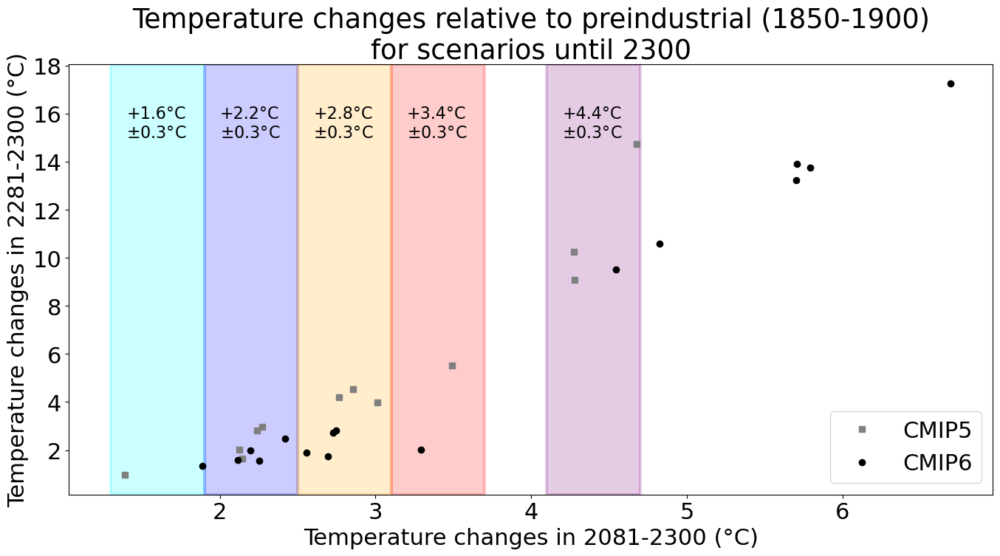

In [245]:
plt.plot(pd_cmip5_temp_ch_2100['global_temp_ch_2081-2100_preindustrial'], pd_cmip5_temp_ch_2100['global_temp_ch_2281-2300_preindustrial'],
         's', label='CMIP5', color='grey')
plt.ylabel('global_temp_ch_2281-2300_preindustrial')
plt.xlabel('global_temp_ch_2081-2100_preindustrial')
plt.gca().axvspan(1.6-0.3, 1.6+0.3, color='cyan', alpha = 0.2,lw=3)
plt.text(1.6-0.2, 15,'+1.6°C\n'+r'$\pm$0.3°C', fontsize=16)
plt.gca().axvspan(2.2-0.3, 2.2+0.3, color='blue', alpha = 0.2,lw=3)
plt.text(2.2-0.2, 15,'+2.2°C\n'+r'$\pm$0.3°C', fontsize=16)

plt.gca().axvspan(2.8-0.3, 2.8+0.3, color='orange', alpha = 0.2,lw=3)
plt.text(2.8-0.2, 15,'+2.8°C\n'+r'$\pm$0.3°C', fontsize=16)

plt.gca().axvspan(3.4-0.3, 3.4+0.3, color='red', alpha = 0.2,lw=3)
plt.text(3.4-0.2, 15,'+3.4°C\n'+r'$\pm$0.3°C', fontsize=16)

plt.gca().axvspan(4.4-0.3, 4.4+0.3, color='purple', alpha = 0.2,lw=3)
plt.text(4.4-0.2, 15,'+4.4°C\n'+r'$\pm$0.3°C', fontsize=16)


plt.plot(pd_cmip6_temp_ch_2100['global_temp_ch_2081-2100_preindustrial'], pd_cmip6_temp_ch_2100['global_temp_ch_2281-2300_preindustrial'],
         'o', label='CMIP6', color='black')
plt.ylabel('Temperature changes in 2281-2300 (°C)')
plt.xlabel('Temperature changes in 2081-2300 (°C)')
plt.title('Temperature changes relative to preindustrial (1850-1900)\nfor scenarios until 2300')
plt.legend()
plt.tight_layout()

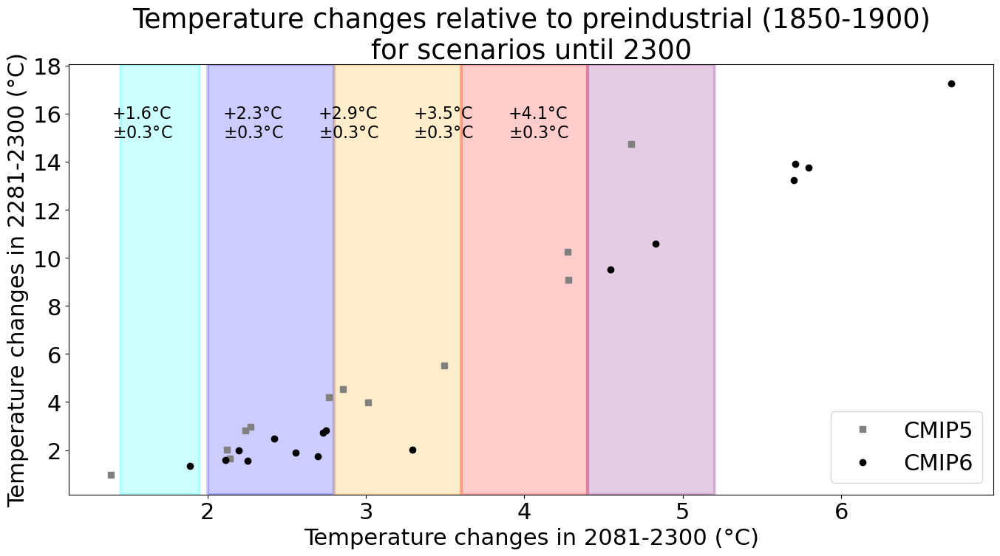

In [237]:
plt.plot(pd_cmip5_temp_ch_2100['global_temp_ch_2081-2100_preindustrial'], pd_cmip5_temp_ch_2100['global_temp_ch_2281-2300_preindustrial'],
         's', label='CMIP5', color='grey')
plt.ylabel('global_temp_ch_2281-2300_preindustrial')
plt.xlabel('global_temp_ch_2081-2100_preindustrial')
plt.gca().axvspan(1.6-0.3, 1.6+0.3, color='cyan', alpha = 0.2,lw=3)
plt.text(1.6-0.2, 15,'+1.6°C\n'+r'$\pm$0.3°C', fontsize=16)
plt.gca().axvspan(2.2-0.3, 2.2+0.3, color='blue', alpha = 0.2,lw=3)
plt.text(2.2-0.2, 15,'+2.3°C\n'+r'$\pm$0.3°C', fontsize=16)

plt.gca().axvspan(2.8-0.3, 2.8+0.3, color='orange', alpha = 0.2,lw=3)
plt.text(2.8-0.2, 15,'+2.9°C\n'+r'$\pm$0.3°C', fontsize=16)

plt.gca().axvspan(3.6-0.3, 3.6+0.3, color='red', alpha = 0.2,lw=3)
plt.text(3.6-0.2, 15,'+3.5°C\n'+r'$\pm$0.3°C', fontsize=16)


plt.gca().axvspan(4.4, 5.2, color='purple', alpha = 0.2,lw=3)
plt.text(4.1-0.2, 15,'+4.1°C\n'+r'$\pm$0.3°C', fontsize=16)


plt.plot(pd_cmip6_temp_ch_2100['global_temp_ch_2081-2100_preindustrial'], pd_cmip6_temp_ch_2100['global_temp_ch_2281-2300_preindustrial'],
         'o', label='CMIP6', color='black')
plt.ylabel('Temperature changes in 2281-2300 (°C)')
plt.xlabel('Temperature changes in 2081-2300 (°C)')
plt.title('Temperature changes relative to preindustrial (1850-1900)\nfor scenarios until 2300')
plt.legend()
plt.tight_layout()

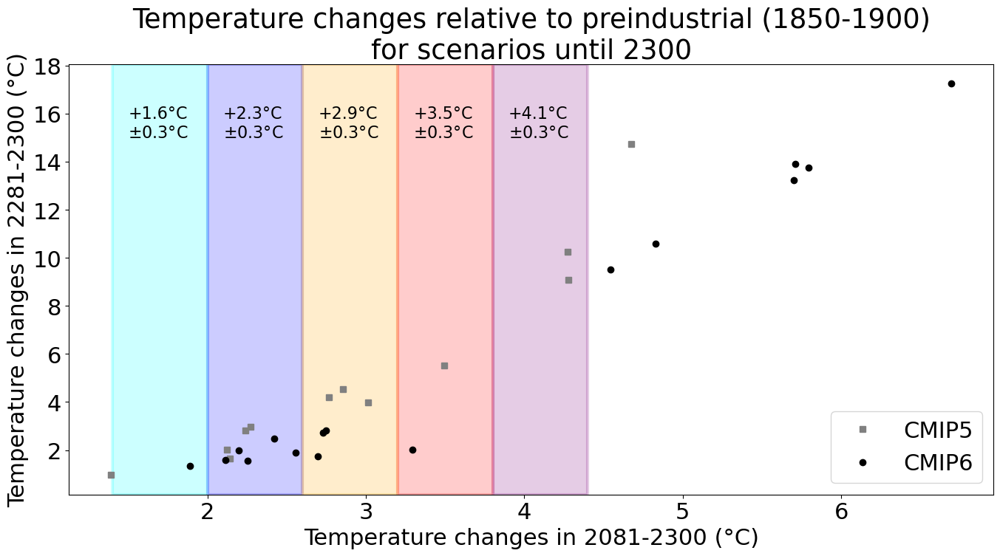

In [233]:
plt.plot(pd_cmip5_temp_ch_2100['global_temp_ch_2081-2100_preindustrial'], pd_cmip5_temp_ch_2100['global_temp_ch_2281-2300_preindustrial'],
         's', label='CMIP5', color='grey')
plt.ylabel('global_temp_ch_2281-2300_preindustrial')
plt.xlabel('global_temp_ch_2081-2100_preindustrial')
plt.gca().axvspan(1.2,2.0, color='cyan', alpha = 0.2,lw=3)
plt.text(1.6-0.2, 15,'+1.6°C\n'+r'$\pm$0.3°C', fontsize=16)
plt.gca().axvspan(2, 2.8, color='blue', alpha = 0.2,lw=3)
plt.text(2.3-0.2, 15,'+2.3°C\n'+r'$\pm$0.3°C', fontsize=16)

plt.gca().axvspan(2.8, 3.6, color='orange', alpha = 0.2,lw=3)
plt.text(2.9-0.2, 15,'+2.9°C\n'+r'$\pm$0.3°C', fontsize=16)

plt.gca().axvspan(3.6, 3.8, color='red', alpha = 0.2,lw=3)
plt.text(3.5-0.2, 15,'+3.5°C\n'+r'$\pm$0.3°C', fontsize=16)


plt.gca().axvspan(3.8, 4.4, color='purple', alpha = 0.2,lw=3)
plt.text(4.1-0.2, 15,'+4.1°C\n'+r'$\pm$0.3°C', fontsize=16)


plt.plot(pd_cmip6_temp_ch_2100['global_temp_ch_2081-2100_preindustrial'], pd_cmip6_temp_ch_2100['global_temp_ch_2281-2300_preindustrial'],
         'o', label='CMIP6', color='black')
plt.ylabel('Temperature changes in 2281-2300 (°C)')
plt.xlabel('Temperature changes in 2081-2300 (°C)')
plt.title('Temperature changes relative to preindustrial (1850-1900)\nfor scenarios until 2300')
plt.legend()
plt.tight_layout()

In [ ]:
plt.plot(pd_cmip5_temp_ch_2100['global_temp_ch_2081-2100_preindustrial'], pd_cmip5_temp_ch_2100['global_temp_ch_2281-2300_preindustrial'],
         's', label='CMIP5', color='grey')
plt.ylabel('global_temp_ch_2281-2300_preindustrial')
plt.xlabel('global_temp_ch_2081-2100_preindustrial')
plt.gca().axvspan(1.4, 2, color='cyan', alpha = 0.2,lw=3)
plt.gca().axvspan(2, 2.6, color='blue', alpha = 0.2,lw=3)
plt.gca().axvspan(2.6, 3.2, color='orange', alpha = 0.2,lw=3)
plt.gca().axvspan(3.2, 3.8, color='red', alpha = 0.2,lw=3)
plt.gca().axvspan(3.8, 4.4, color='purple', alpha = 0.2,lw=3)


plt.plot(pd_cmip6_temp_ch_2100['global_temp_ch_2081-2100_preindustrial'], pd_cmip6_temp_ch_2100['global_temp_ch_2281-2300_preindustrial'],
         'o', label='CMIP6', color='black')
plt.ylabel('Temperature changes in 2281-2300 (°C)')
plt.xlabel('Temperature changes in 2081-2300 (°C)')
plt.title('Temperature changes relative to preindustrial (1850-1900)\nfor scenarios until 2300')
plt.legend()
plt.tight_layout()
plt.savefig('overview_temperature_levels.png')

NameError: name 'colors_temp' is not defined

Series([], Name: global_temp_ch_2081-2100_preindustrial, dtype: float64)

In [ ]:
temp_ch_2081_2100_rel_preind = pd_temp_ch_2100_2300.loc[j, 'global_temp_ch_2081-2100_preindustrial'] 
        if (temp_ch_2081_2100_rel_preind <=1.75) and ((temp_ch_2081_2100_rel_preind >=1.25)):

In [375]:
temp_lev_reality

{'+1.5°C': '+1.4°C',
 '+2.0°C': '+2.2°C',
 '+3.0°C': '+2.8°C',
 '+4.0°C': '+4.3°C',
 '+5.0°C': '+4.7°C'}

In [692]:
pd_cmip5_temp_ch_2100

,gcm,rcp,global_temp_ch_2081-2100_preindustrial,global_temp_ch_2281-2300_preindustrial,global_temp_ch_level_2081-2100_preindustrial_+2.0°C,global_temp_ch_level_2081-2100_preindustrial_+3.0°C,global_temp_ch_level_2081-2100_preindustrial_+1.5°C,global_temp_ch_level_2081-2100_preindustrial_+4.0°C,global_temp_ch_level_2081-2100_preindustrial_+5.0°C
CCSM4_rcp45,CCSM4,rcp45,2.295509,NaN,True,NaN,NaN,NaN,NaN
MPI-ESM-LR_rcp45,MPI-ESM-LR,rcp45,2.271968,2.958780,True,NaN,NaN,NaN,NaN
CNRM-CM5_rcp45,CNRM-CM5,rcp45,2.538656,NaN,NaN,True,NaN,NaN,NaN
GFDL-ESM2G_rcp45,GFDL-ESM2G,rcp45,1.600477,NaN,True,NaN,True,NaN,NaN
CSIRO-MK3-6-0_rcp45,CSIRO-MK3-6-0,rcp45,2.854896,4.546949,NaN,True,NaN,NaN,NaN
IPSL-CM5A-LR_rcp45,IPSL-CM5A-LR,rcp45,2.774394,NaN,NaN,True,NaN,NaN,NaN
GFDL-CM3_rcp45,GFDL-CM3,rcp45,3.387849,NaN,NaN,True,NaN,NaN,NaN
NORESM1-M_rcp45,NORESM1-M,rcp45,2.240951,2.816447,True,NaN,NaN,NaN,NaN
GISS-E2-R_rcp45,GISS-E2-R,rcp45,1.852433,NaN,True,NaN,NaN,NaN,NaN
CANESM2_rcp45,CANESM2,rcp45,2.951594,NaN,NaN,True,NaN,NaN,NaN


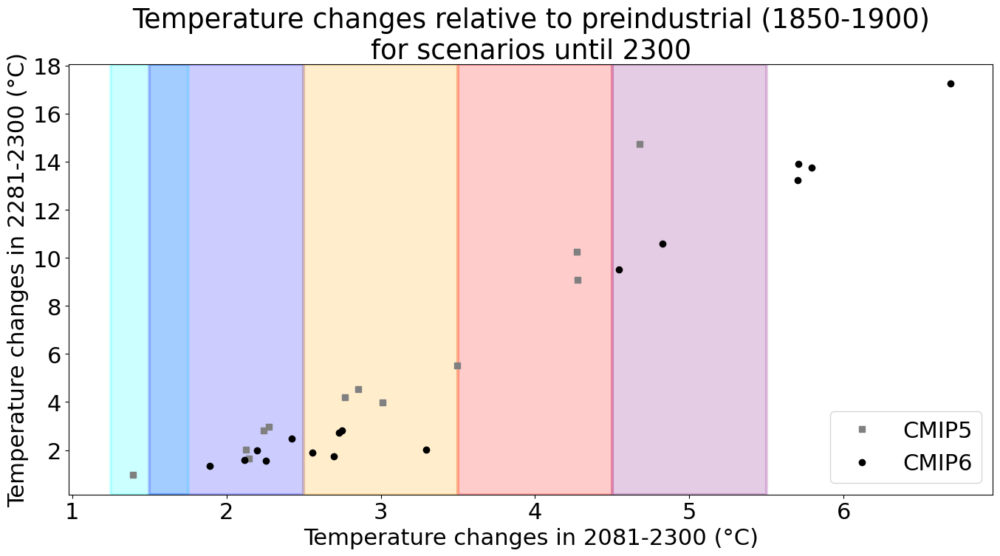

In [136]:
df_rel_q25 = pd.DataFrame(df_rel_l).T.quantile(0.25, axis=1)
df_rel_q75 = pd.DataFrame(df_rel_l).T.quantile(0.75, axis=1)

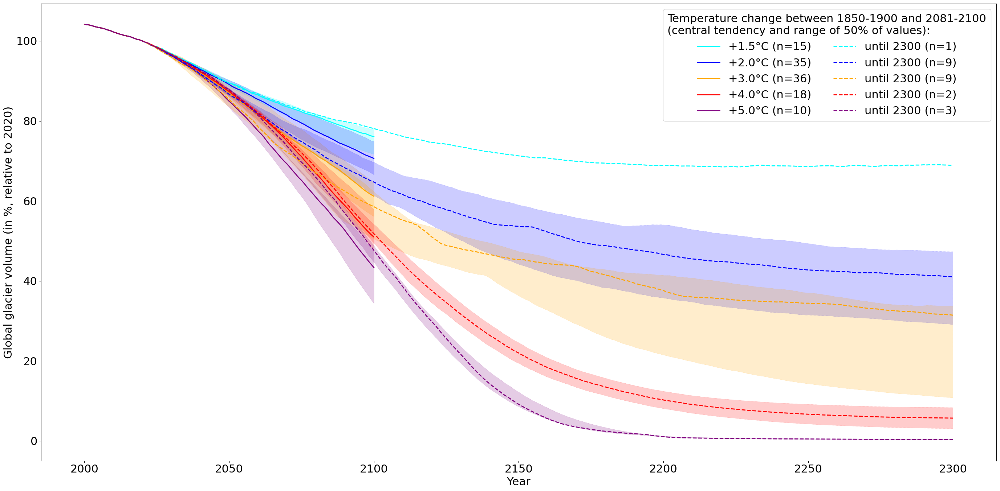

In [156]:

colors_temp= {'+1.5°C':'cyan', '+2.0°C':'blue', '+3.0°C':'orange', '+4.0°C':'red', '+5.0°C':'purple'}
plt.figure(figsize=(28,14)) #harey=True, sharex=True)

plt.rc('font', size=22)
ax = plt.gca()
for end_year,ls in zip(['2100', '2300'], ['-','--']):
    for temp_lev in colors_temp.keys():
        df_rel_l = []

        for cmip,pd_cmip in zip(['CMIP5','CMIP6'], [pd_cmip5_temp_ch_2100, pd_cmip6_temp_ch_2100]):
            for gcm_scenario in pd_cmip[f'global_temp_ch_level_2081-2100_preindustrial_{temp_lev}'].dropna().index:
                try:
                    gcm, scenario = gcm_scenario.split('_')
                    n = len(gcm_scenario)
                    idir = path + '/common_running_2100_2300/' + f'volume/{cmip}/{end_year}/global/'
                    df = pd.read_csv(idir + f'{scenario}.csv', index_col=0)
                    df = df[gcm.upper()]
                    df_rel = 100*df/df.loc[2020]
                    df_rel_l.append(df_rel)
                except:
                    pass
        if len(df_rel_l) > 0:
            df_rel_med = pd.DataFrame(df_rel_l).T.median(axis=1)
            if end_year == '2100':
                label = f'{temp_lev} (n={len(df_rel_l)})'
            else:
                label = f'until 2300 (n={len(df_rel_l)})'
            ax.plot(df.index, df_rel_med, lw=2, color=colors_temp[temp_lev],
                                label = label, ls=ls)

            df_rel_q25 = pd.DataFrame(df_rel_l).T.quantile(0.25, axis=1)
            df_rel_q75 = pd.DataFrame(df_rel_l).T.quantile(0.75, axis=1)
            ax.fill_between(df.index, df_rel_q25, df_rel_q75, lw=0.5, alpha=0.2, 
                                color=colors_temp[temp_lev],
                                    ls = ls)

plt.ylabel('Global glacier volume (in %, relative to 2020)')
plt.xlabel('Year')
plt.legend(title='Temperature change between 1850-1900 and 2081-2100\n(central tendency and range of 50% of values):', ncol=2)
plt.tight_layout()
plt.savefig('first_trial_only_oggm.png')

,gcm,ssp,global_temp_ch_2081-2100_preindustrial,global_temp_ch_2281-2300_preindustrial,global_temp_ch_level_2081-2100_preindustrial_+2.0°C,global_temp_ch_level_2081-2100_preindustrial_+4.0°C,global_temp_ch_level_2081-2100_preindustrial_+6.0°C,global_temp_ch_level_2081-2100_preindustrial_+3.0°C,global_temp_ch_level_2081-2100_preindustrial_+1.5°C,global_temp_ch_level_2081-2100_preindustrial_+5.0°C
CESM2-WACCM_ssp126,CESM2-WACCM,ssp126,2.420132,2.468365,True,NaN,NaN,NaN,NaN,NaN
CESM2-WACCM_ssp370,CESM2-WACCM,ssp370,4.266955,NaN,NaN,True,NaN,NaN,NaN,NaN
CESM2-WACCM_ssp585,CESM2-WACCM,ssp585,5.699997,13.237817,NaN,NaN,True,NaN,NaN,NaN
CESM2-WACCM_ssp245,CESM2-WACCM,ssp245,3.283423,NaN,NaN,NaN,NaN,True,NaN,NaN
MPI-ESM1-2-HR_ssp585,MPI-ESM1-2-HR,ssp585,3.934656,NaN,NaN,True,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
NORESM2-MM_ssp245,NORESM2-MM,ssp245,2.425465,NaN,True,NaN,NaN,NaN,NaN,NaN
EC-EARTH3_ssp245,EC-EARTH3,ssp245,3.288184,NaN,NaN,NaN,NaN,True,NaN,NaN
EC-EARTH3-VEG_ssp245,EC-EARTH3-VEG,ssp245,3.150037,NaN,NaN,NaN,NaN,True,NaN,NaN
FGOALS-F3-L_ssp245,FGOALS-F3-L,ssp245,2.591095,NaN,NaN,NaN,NaN,True,NaN,NaN


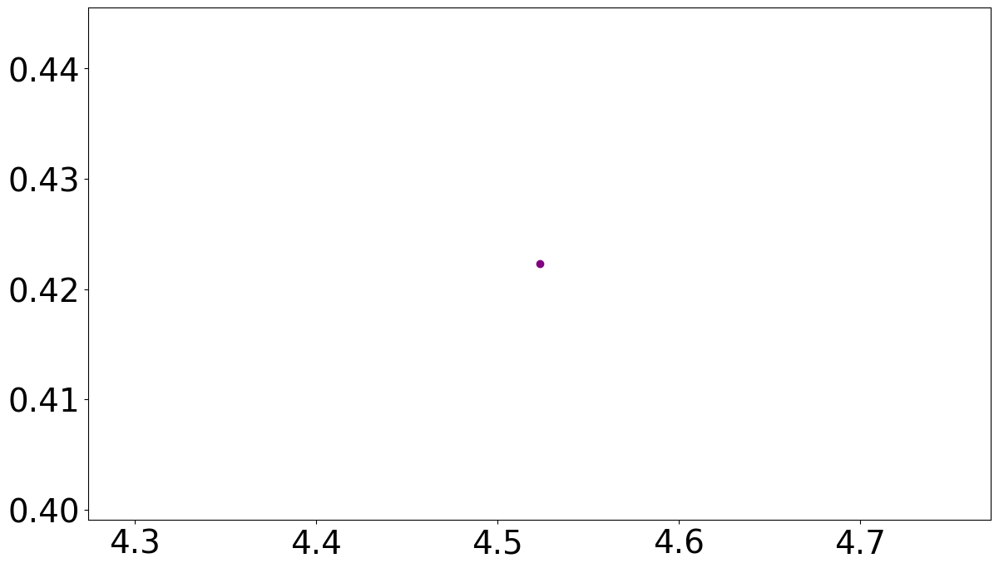

In [422]:
plt.plot([pd_cmip.loc[gcm_scenario, 'global_temp_ch_2081-2100_preindustrial']], [df_rel.loc[2300]], colors_temp[temp_lev], marker='o')

In [427]:
pd_cmip_temp_ch_2100 = pd.concat([pd_cmip6_temp_ch_2100, pd_cmip5_temp_ch_2100])
pd_cmip_temp_ch_2100 = pd_cmip_temp_ch_2100.loc[pd_cmip_temp_ch_2100.ssp != 'ssp534-over']
index_2300 = pd_cmip_temp_ch_2100['global_temp_ch_2281-2300_preindustrial'].dropna().index
temp_lev_reality = {}
for temp_lev in colors_temp.keys():
    _t = pd_cmip_temp_ch_2100.loc[pd_cmip_temp_ch_2100.loc[index_2300,
                                                            f'global_temp_ch_level_2081-2100_preindustrial_{temp_lev}'].dropna().index,
                                  'global_temp_ch_2081-2100_preindustrial'].median().round(1)
    temp_lev_reality[temp_lev] = f'+{_t}°C'

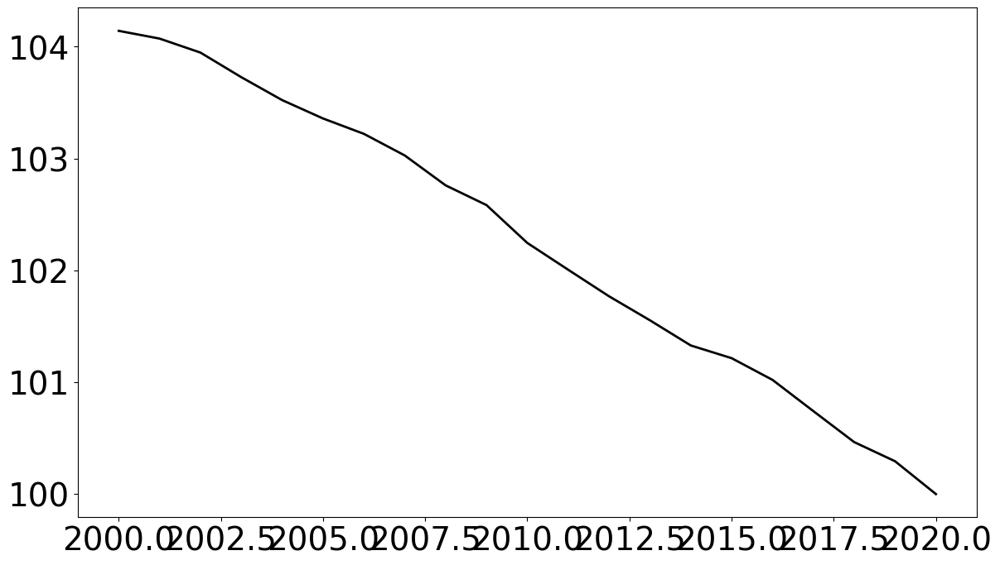

In [433]:
plt.plot(df_rel.loc[2000:2020].index, df_rel.loc[2000:2020], lw=2, color='black',
                           ) #label = label, ls=ls)

In [434]:
                    gcm, scenario = gcm_scenario.split('_')
                    n = len(gcm_scenario)
                    idir = path_oggm + '/common_running_2100_2300/' + f'volume/{cmip}/{end_year}/global/'
                    df = pd.read_csv(idir + f'{scenario}.csv', index_col=0)
                    df = df[gcm.upper()]
                    df_rel = 100*df/df.loc[2020]
                    axs[0].plot(df.index, df_rel, lw=2, color=colors_temp[temp_lev],
                           ) #label = label, ls=ls)
                    axs[0].plot(df_rel.loc[2000:2020].index, df_rel.loc[2000:2020], lw=2, color='black',
                           ) #label = label, ls=ls)
                    
                    axs[1].plot([pd_cmip.loc[gcm_scenario, 'global_temp_ch_2081-2100_preindustrial']], [df_rel.loc[2100]], colors_temp[temp_lev], marker='o')
                    axs[2].plot([pd_cmip.loc[gcm_scenario, 'global_temp_ch_2081-2100_preindustrial']], [df_rel.loc[2300]], colors_temp[temp_lev], marker='o')

FileNotFoundError: [Errno 2] No such file or directory: '/home/lilianschuster/oggm-standard-projections-csv-files/1.6.1/common_running_2100_2300/volume/CMIP6/2300/global/ssp370.csv'

In [543]:
d_reg_num_name_icci_reg

{'low-latitudes': ['16'],
 'mid-latitudes': ['08', '11', '02', '18'],
 'polar-hma': ['06', '13-14-15', '01', '04', '17']}

In [553]:
pd_proj_2100_2300.columns

Index(['global_temp_ch_2081-2100_preindustrial', 'rel_ice_2100_RGI16',
       'rel_ice_2300_RGI16', 'rel_ice_2100_RGI08', 'rel_ice_2300_RGI08',
       'rel_ice_2100_RGI11', 'rel_ice_2300_RGI11', 'rel_ice_2100_RGI02',
       'rel_ice_2300_RGI02', 'rel_ice_2100_RGI18', 'rel_ice_2300_RGI18',
       'rel_ice_2100_RGI06', 'rel_ice_2300_RGI06', 'rel_ice_2100_RGI13-14-15'],
      dtype='object')

In [554]:
pd_proj_2100_2300 = pd.DataFrame(index=pd_cmip_temp_ch_2100.index)


In [568]:
gcm_scenario = 'EC-EARTH3_ssp370'

'EC-EARTH3_ssp370'

In [567]:
                            gcm, scenario = gcm_scenario.split('_')
                            n = len(gcm_scenario)
                            if _rgi_reg == '13-14-15':
                                odf = 0
                                for sub_rgi_reg in ['RGI13','RGI14','RGI15']:
                                    idir = path_oggm + '/common_running_2100_2300/' + f'volume/{cmip}/{end_year}/{sub_rgi_reg}/'
                                    _df = pd.read_csv(idir + f'{scenario}.csv', index_col=0)
                                    _df = _df[gcm.upper()]
                                    df += _df
                                    print('test')
                            else:
                                idir = path_oggm + '/common_running_2100_2300/' + f'volume/{cmip}/{end_year}/{rgi_reg}/'
                                df = pd.read_csv(idir + f'{scenario}.csv', index_col=0)
                                df = df[gcm.upper()]
                            df_rel = 100*df/df.loc[2020]
                            ax.plot(df.loc[2020:].index, df_rel.loc[2020:], lw=2, color=colors_temp[temp_lev],
                                   ) #label = label, ls=ls)
                            ax.plot(df.loc[2000:2020].index, df_rel.loc[2000:2020], lw=3, color='black',
                                   ) #label = label, ls=ls)
                            pd_proj_2100_2300.loc[gcm_scenario, 'global_temp_ch_2081-2100_preindustrial'] = pd_cmip.loc[gcm_scenario, 'global_temp_ch_2081-2100_preindustrial']
                            pd_proj_2100_2300.loc[gcm_scenario, f'rel_ice_2100_{rgi_reg}'] = df_rel.loc[2100]
                            pd_proj_2100_2300.loc[gcm_scenario, f'rel_ice_2300_{rgi_reg}'] = df_rel.loc[2300]

FileNotFoundError: [Errno 2] No such file or directory: '/home/lilianschuster/oggm-standard-projections-csv-files/1.6.1/common_running_2100_2300/volume/CMIP6/2300/RGI13/ssp370.csv'

In [572]:
pd_proj_2100_2300

,global_temp_ch_2081-2100_preindustrial,rel_ice_2100_RGI16,rel_ice_2300_RGI16
CESM2-WACCM_ssp126,2.420132,20.579757,18.105627
CESM2-WACCM_ssp370,NaN,NaN,NaN
CESM2-WACCM_ssp585,NaN,NaN,NaN
CESM2-WACCM_ssp245,NaN,NaN,NaN
MPI-ESM1-2-HR_ssp585,NaN,NaN,NaN
...,...,...,...
MPI-ESM-LR_rcp85,4.272514,1.844672,0.042365
CNRM-CM5_rcp85,NaN,NaN,NaN
GFDL-ESM2G_rcp85,NaN,NaN,NaN
CANESM2_rcp85,NaN,NaN,NaN


In [577]:
pd_cmip_temp_ch_2100.loc[index_2300].index

Index(['CESM2-WACCM_ssp126', 'CESM2-WACCM_ssp585', 'ACCESS-ESM1-5_ssp585',
       'ACCESS-ESM1-5_ssp126', 'ACCESS-CM2_ssp126', 'ACCESS-CM2_ssp585',
       'IPSL-CM6A-LR_ssp585', 'IPSL-CM6A-LR_ssp126', 'MRI-ESM2-0_ssp585',
       'MRI-ESM2-0_ssp126', 'CANESM5_ssp126', 'CANESM5_ssp585',
       'MPI-ESM-LR_rcp45', 'CSIRO-MK3-6-0_rcp45', 'NORESM1-M_rcp45',
       'CESM1-CAM5_rcp45', 'CCSM4_rcp60', 'CESM1-CAM5_rcp60',
       'MPI-ESM-LR_rcp26', 'CANESM2_rcp26', 'CESM1-CAM5_rcp26',
       'CSIRO-MK3-6-0_rcp85', 'CCSM4_rcp85', 'MPI-ESM-LR_rcp85'],
      dtype='object')

In [586]:
gcm_scenario = 'CESM2-WACCM_ssp126'
gcm, scenario = gcm_scenario.split('_')
n = len(gcm_scenario)
if _rgi_reg == '13-14-15':
    df = 0
    for sub_rgi_reg in ['RGI13','RGI14','RGI15']:
        idir = path_oggm + '/common_running_2100_2300/' + f'volume/{cmip}/{end_year}/{sub_rgi_reg}/'
        _df = pd.read_csv(idir + f'{scenario}.csv', index_col=0)
        _df = _df[gcm.upper()]
        df += _df

In [588]:
df

time
2000.0    7.072664e+12
2001.0    7.049744e+12
2002.0    7.015349e+12
2003.0    6.996027e+12
2004.0    7.012812e+12
              ...     
2296.0    3.567387e+12
2297.0    3.578332e+12
2298.0    3.603008e+12
2299.0    3.601403e+12
2300.0    3.578567e+12
Name: CESM2-WACCM, Length: 301, dtype: float64

In [585]:
                            gcm, scenario = gcm_scenario.split('_')
                            n = len(gcm_scenario)
                            if _rgi_reg == '13-14-15':
                                df = 0
                                for sub_rgi_reg in ['RGI13','RGI14','RGI15']:
                                    idir = path_oggm + '/common_running_2100_2300/' + f'volume/{cmip}/{end_year}/{sub_rgi_reg}/'
                                    _df = pd.read_csv(idir + f'{scenario}.csv', index_col=0)
                                    _df = _df[gcm.upper()]
                                    df += _df

FileNotFoundError: [Errno 2] No such file or directory: '/home/lilianschuster/oggm-standard-projections-csv-files/1.6.1/common_running_2100_2300/volume/CMIP6/2300/RGI13/ssp119.csv'

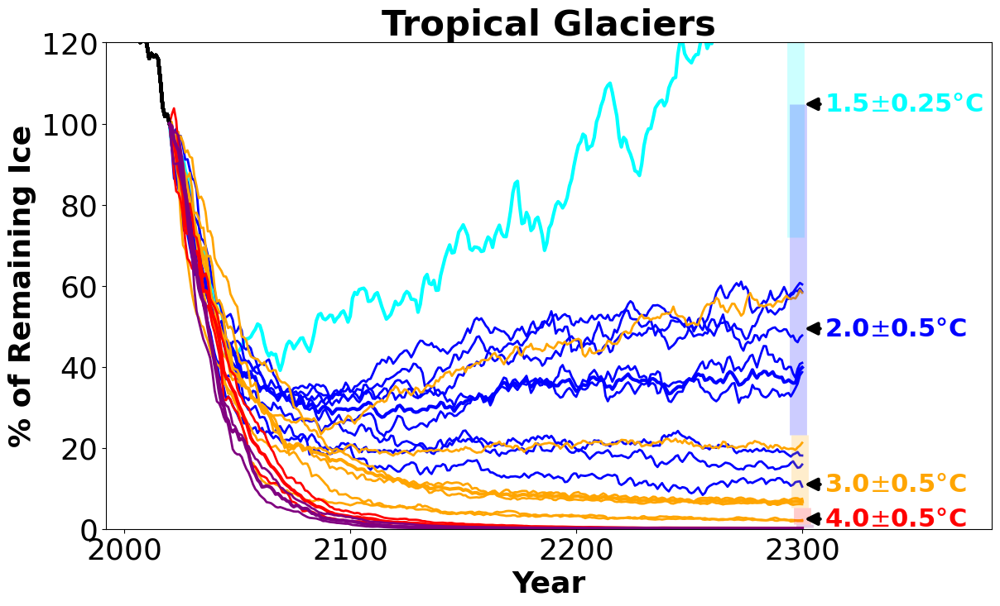

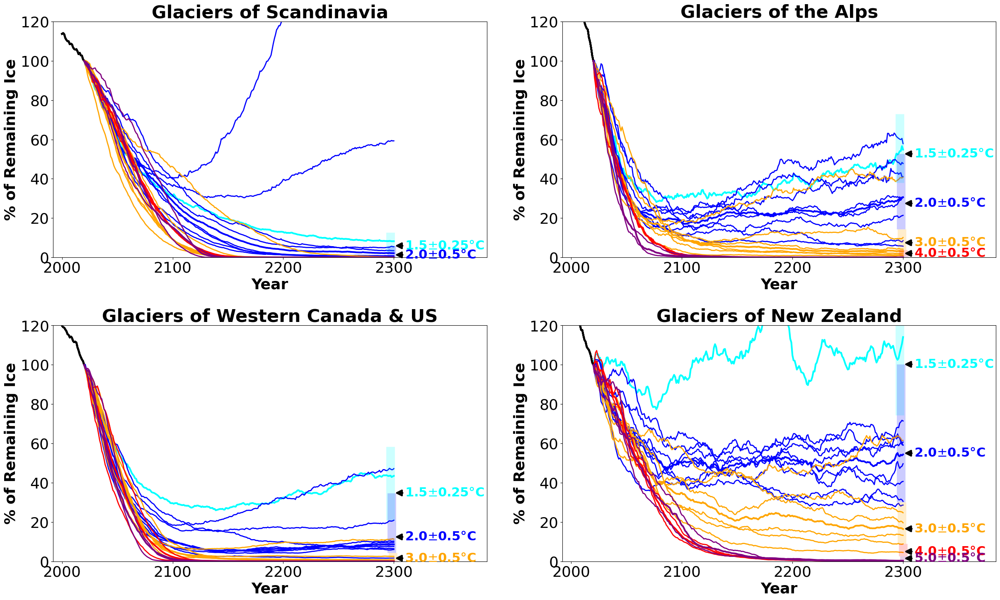

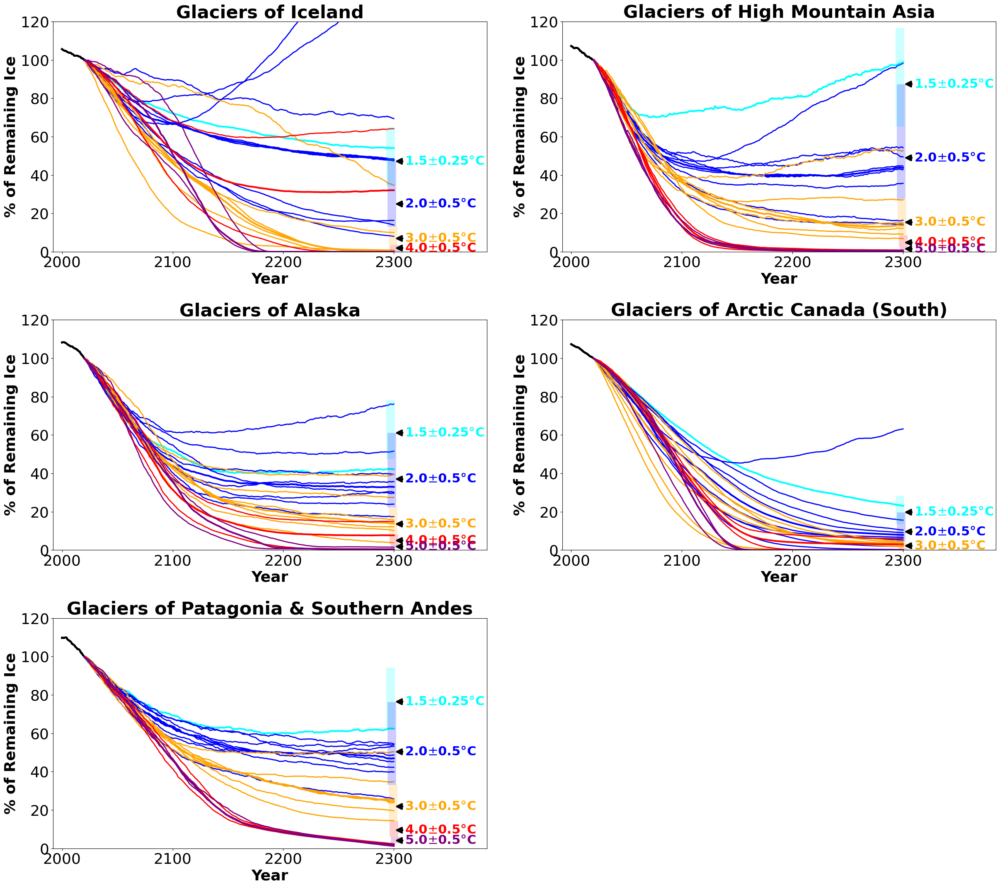

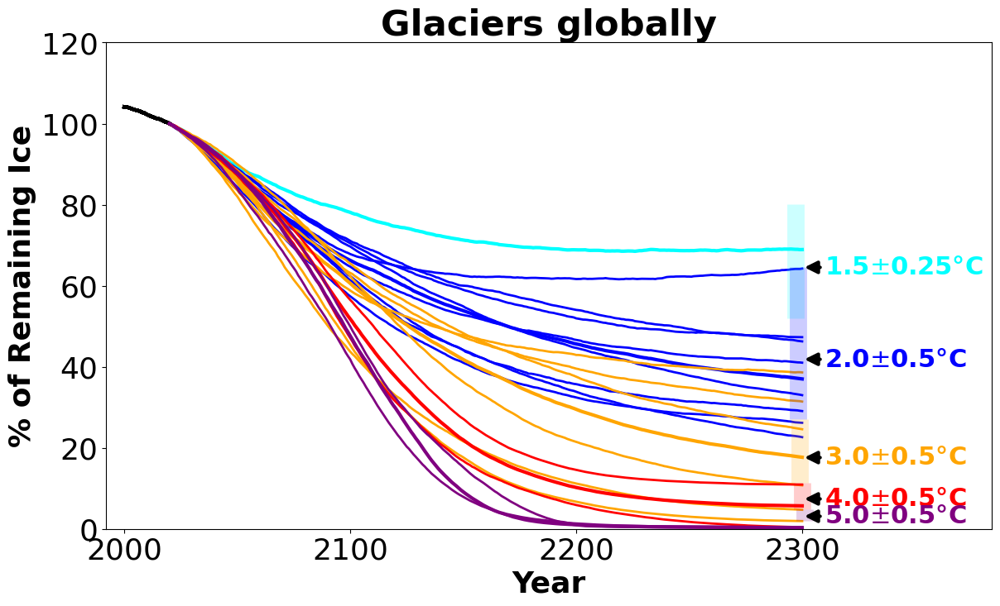

In [610]:
plt.rc('font', size=26)

for reg in d_reg_num_name_icci_reg.keys():

    rgi_regs = d_reg_num_name_icci_reg[reg]
    
    fig, axs = plt.subplots(3,2, figsize=(25,22)) #harey=True, sharex=True)
    axs = axs.flatten()
    len_sub_p = len(rgi_regs)

    for jj,_rgi_reg in enumerate(rgi_regs): 
        pd_proj_2100_2300 = pd.DataFrame(index=pd_cmip_temp_ch_2100.index)

        if _rgi_reg !='global':
            rgi_reg = f'RGI{_rgi_reg}'
        else:
            rgi_reg = _rgi_reg 
        ax = axs[jj]
        for end_year,ls in zip(['2300'], ['-']):
            for temp_lev in colors_temp.keys():
                df_rel_l = []

                for cmip,pd_cmip in zip(['CMIP5','CMIP6'],
                                        [pd_cmip5_temp_ch_2100, pd_cmip6_temp_ch_2100.loc[pd_cmip6_temp_ch_2100.ssp != 'ssp534-over']]):
                    for gcm_scenario in pd_cmip[f'global_temp_ch_level_2081-2100_preindustrial_{temp_lev}'].dropna().index:
                        try:
                            gcm, scenario = gcm_scenario.split('_')
                            n = len(gcm_scenario)
                            if _rgi_reg == '13-14-15':
                                df = 0
                                for sub_rgi_reg in ['RGI13','RGI14','RGI15']:
                                    idir = path_oggm + '/common_running_2100_2300/' + f'volume/{cmip}/{end_year}/{sub_rgi_reg}/'
                                    _df = pd.read_csv(idir + f'{scenario}.csv', index_col=0)
                                    _df = _df[gcm.upper()]
                                    df += _df
                            else:
                                idir = path_oggm + '/common_running_2100_2300/' + f'volume/{cmip}/{end_year}/{rgi_reg}/'
                                df = pd.read_csv(idir + f'{scenario}.csv', index_col=0)
                                df = df[gcm.upper()]
                            df_rel = 100*df/df.loc[2020]
                            ax.plot(df.loc[2020:].index, df_rel.loc[2020:], lw=2, color=colors_temp[temp_lev],
                                   ) #label = label, ls=ls)
                            ax.plot(df.loc[2000:2020].index, df_rel.loc[2000:2020], lw=3, color='black',
                                   ) #label = label, ls=ls)
                            pd_proj_2100_2300.loc[gcm_scenario, 'global_temp_ch_2081-2100_preindustrial'] = pd_cmip.loc[gcm_scenario, 'global_temp_ch_2081-2100_preindustrial']
                            pd_proj_2100_2300.loc[gcm_scenario, f'rel_ice_2100_{rgi_reg}'] = df_rel.loc[2100]
                            
                            pd_proj_2100_2300.loc[gcm_scenario, f'rel_ice_2300_{rgi_reg}'] = df_rel.loc[2300]
                            #if _rgi_reg == '13-14-15':
                            #    print('test')
                            df_rel_l.append(df_rel)
                        except:
                            pass
                if len(df_rel_l) > 0:
                    df_rel_med = pd.DataFrame(df_rel_l).T.median(axis=1)
                    if temp_lev == '+1.5°C':
                        bound = 0.25
                    else:
                        bound = 0.50
                    label = f'{temp_lev}\n'+r'$\pm$'+f'{bound}°C' #' (n={len(df_rel_l)}), in reality: {temp_lev_reality[temp_lev]}'
                    ax.plot(df_rel_med.loc[2020:].index, df_rel_med.loc[2020:], lw=0, color=colors_temp[temp_lev],
                                        label = label, ls=ls)

                    #df_rel_q25 = pd.DataFrame(df_rel_l).T.quantile(0.25, axis=1)
                    #df_rel_q75 = pd.DataFrame(df_rel_l).T.quantile(0.75, axis=1)
                    #ax.fill_between(df.index, df_rel_q25, df_rel_q75, lw=0.5, alpha=0.2, 
                    #                    color=colors_temp[temp_lev],
                    #                         ls = ls)
        ax.set_ylim([0,120])
        ax.set_ylabel('% of Remaining Ice',# (relative to 2020)',
                      fontweight = 'bold')
        ax.set_xlabel('Year',  fontweight = 'bold')
        handles, labels = ax.get_legend_handles_labels()
        for h in handles:
            h.set_linewidth(3)
        ax.legend(handles, labels,
                      handlelength=1,
                      title='Temperature change between 1850-1900 & 2081-2100:', ncol=5)
        ax.legend().remove()

        ax.set_title(d_reg_num_name_icci[_rgi_reg], fontweight='bold')

        pd_proj_2100_2300 = pd_proj_2100_2300.dropna()

        for j,sim_year in enumerate([2100, 2300]):
            # Perform the curve fitting
            x = pd_proj_2100_2300['global_temp_ch_2081-2100_preindustrial']
            popt, pcov = curve_fit(exponential_decay, x,
                                   pd_proj_2100_2300[f'rel_ice_{sim_year}_{rgi_reg}'],
                                   loss='soft_l1', f_scale=0.1, bounds = param_bounds)  # Lower and upper bounds for a and b)
            # Generate a higher density x range for plotting the fitted curve
            x_dense = np.linspace(x.min(), x.max(), 100)
            # Extract the optimized parameters
            a_opt, b_opt = popt #c_opt
            y_fitted = exponential_decay(x_dense, a_opt, b_opt)
            pd_exp_decay_fits_simple.iloc[jj] = (rgi_reg,sim_year, a_opt, b_opt)
            if sim_year == 2300:
                for j,temp_lev in enumerate(colors_temp.keys()):
                    fit = exponential_decay(float(temp_lev[1:4]), a_opt, b_opt)

                    if temp_lev == '+1.5°C':
                        bound = 0.25
                    else:
                        bound = 0.5
                    if fit >1:
                        ax.annotate(temp_lev[1:4]+r'$\pm$'+f'{bound}°C', xy=(2300, fit), xytext=(2310, fit),
                                        verticalalignment="center",
                                        arrowprops=dict(arrowstyle= '-|>', color='black', lw=3), color=colors_temp[temp_lev], alpha=1, fontweight = 'bold', fontsize=22)
                    y_fitted = exponential_decay(np.array([float(temp_lev[1:4])-bound, float(temp_lev[1:4])+bound]), a_opt, b_opt)
                    ax.vlines(2300-3+j*1,y_fitted[0], y_fitted[1], color=colors_temp[temp_lev], lw=15, alpha = 0.2)

            elif sim_year == 2100:
                for j,temp_lev in enumerate(colors_temp.keys()):
                    if temp_lev == '+1.5°C':
                        bound = 0.25
                    else:
                        bound = 0.5
                    y_fitted = exponential_decay(np.array([float(temp_lev[1:4])-bound, float(temp_lev[1:4])+bound]), a_opt, b_opt)
                    #axs[0].vlines(2100-3+j*1,y_fitted[0], y_fitted[1], color=colors_temp[temp_lev], lw=15, alpha = 0.2)
                    #axs[0].annotate(temp_lev, xy=(2300, fit), xytext=(2310, fit),
                    #                verticalalignment="center",
                    #                arrowprops=dict(arrowstyle= '-|>', color='black', lw=3), color=colors_temp[temp_lev], alpha=1, fontweight = 'bold')
        ax.set_xlim([1992, 2384])
        ax.set_xticks([2000,2100,2200,2300])
    plt.tight_layout()
    for j in np.arange(len(axs)-len_sub_p):
        fig.delaxes(axs[len(axs)-j-1])
        
    plt.savefig(f'icci_report_2023_only_oggm_temp_levels_{reg}.png')

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


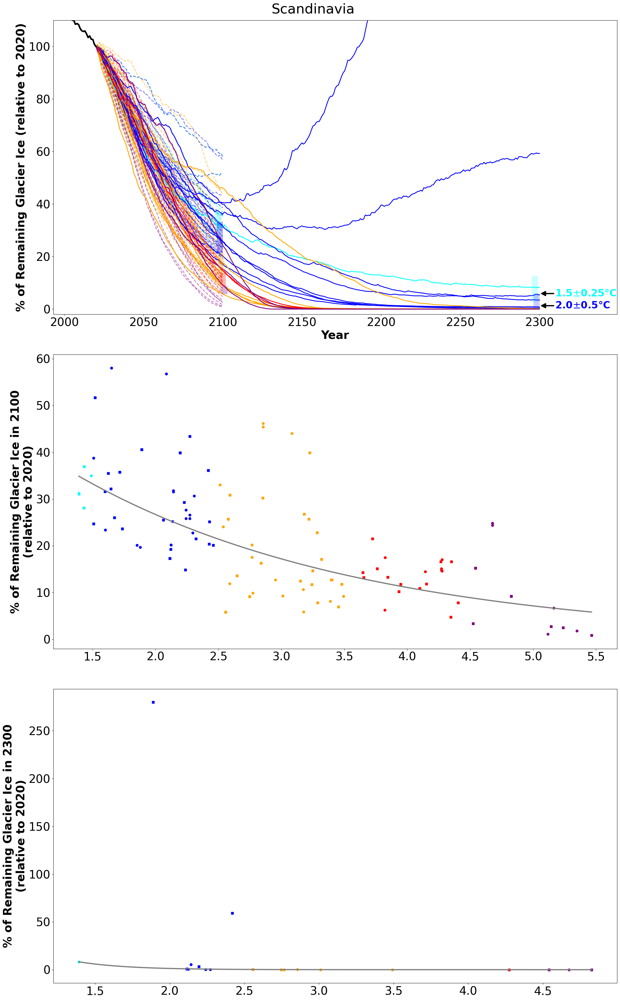

In [681]:
######################
pd_proj_2100_2300 = pd.DataFrame(index=pd_cmip_temp_ch_2100.index )

from scipy.optimize import curve_fit

def exponential_decay(x, a, b):
    # avoind overflow -> does not work ... 
    exp_values = -b * x
    #exp_values = np.clip(exp_values, -709, 709)  # Clip values to avoid overflow
    return a * np.exp(exp_values) #+ c * np.exp(-d * x**2)#**c 
param_bounds = ([0, 0], [1000, 5])
pd_exp_decay_fits_simple = pd.DataFrame(index=np.arange(0,20*4,1),
                                        columns=['rgi_reg','year',
                                                 'a', 'b'])
rgi_regs_global = ['global','01', '02', '03', '04', '05', '06', '07',
                   '08', '09', '10', '11', '12', '13', '14', '15',
                   '16', '17', '18', '19']


path_oggm = '/home/lilianschuster/oggm-standard-projections-csv-files/1.6.1'
colors_temp= {'+1.5°C':'cyan', '+2.0°C':'blue', '+3.0°C':'orange', '+4.0°C':'red', '+5.0°C':'purple'}

for jj,_rgi_reg in enumerate(['08']):#rgi_regs_global[0]]):
    if _rgi_reg !='global':
        rgi_reg = f'RGI{_rgi_reg}'
    else:
        rgi_reg = _rgi_reg 
    fig, axs = plt.subplots(3,1, figsize=(22,35)) #harey=True, sharex=True)
    plt.rc('font', size=28)
    for end_year,ls in zip(['2100','2300'], ['--','-']):
        for temp_lev in colors_temp.keys():
            df_rel_l = []

            for cmip,pd_cmip in zip(['CMIP5','CMIP6'],
                                    [pd_cmip5_temp_ch_2100, pd_cmip6_temp_ch_2100.loc[pd_cmip6_temp_ch_2100.ssp != 'ssp534-over']]):
                for gcm_scenario in pd_cmip[f'global_temp_ch_level_2081-2100_preindustrial_{temp_lev}'].dropna().index:
                    try:
                        gcm, scenario = gcm_scenario.split('_')
                        n = len(gcm_scenario)

                        idir = path_oggm + '/common_running_2100_2300/' + f'volume/{cmip}/{end_year}/{rgi_reg}/'
                        df = pd.read_csv(idir + f'{scenario}.csv', index_col=0)
                        df = df[gcm.upper()]
                        df_rel = 100*df/df.loc[2020]
                        if end_year =='2100':
                            alpha = 0.5
                        else:
                            alpha = 1
                        axs[0].plot(df.loc[2020:].index, df_rel.loc[2020:], lw=2, color=colors_temp[temp_lev],ls=ls, alpha = alpha,
                               ) #label = label, ls=ls)
                        axs[0].plot(df.loc[2000:2020].index, df_rel.loc[2000:2020], lw=0.5, color='black',ls=ls, alpha = alpha,
                               ) #label = label, ls=ls)
                        df_rel_l.append(df_rel)

                        pd_proj_2100_2300.loc[gcm_scenario, 'global_temp_ch_2081-2100_preindustrial'] = pd_cmip.loc[gcm_scenario, 'global_temp_ch_2081-2100_preindustrial']
                        if cmip == 'CMIP5':
                            marker = 'o'
                        else:
                            marker = 's'
                        axs[1].plot([pd_cmip.loc[gcm_scenario, 'global_temp_ch_2081-2100_preindustrial']], [df_rel.loc[2100]], colors_temp[temp_lev], marker=marker)
                        pd_proj_2100_2300.loc[gcm_scenario, f'rel_ice_2100_{rgi_reg}'] = df_rel.loc[2100]    
                        
                        axs[2].plot([pd_cmip.loc[gcm_scenario, 'global_temp_ch_2081-2100_preindustrial']], [df_rel.loc[2300]], colors_temp[temp_lev], marker=marker)
                        pd_proj_2100_2300.loc[gcm_scenario, f'rel_ice_2300_{rgi_reg}'] = df_rel.loc[2300]    

                    except:
                        pass
            #if len(df_rel_l) > 0:
            #    df_rel_med = pd.DataFrame(df_rel_l).T.median(axis=1)
            #    if temp_lev == '+1.5°C':
            #        bound = 0.25
            #    else:
            #        bound = 0.50
            #    label = f'{temp_lev}\n'+r'$\pm$'+f'{bound}°C' #' (n={len(df_rel_l)}), in reality: {temp_lev_reality[temp_lev]}'
            #    axs[0].plot(df.loc[2020:].index, df_rel_med.loc[2020:], lw=0, color=colors_temp[temp_lev],
            #                       label = label, ls=ls)

            #df_rel_q25 = pd.DataFrame(df_rel_l).T.quantile(0.25, axis=1)
            #df_rel_q75 = pd.DataFrame(df_rel_l).T.quantile(0.75, axis=1)
            #ax.fill_between(df.index, df_rel_q25, df_rel_q75, lw=0.5, alpha=0.2, 
            #                    color=colors_temp[temp_lev],
            #                         ls = ls)
    axs[0].set_ylim([-2,110])
    axs[0].set_ylabel('% of Remaining Glacier Ice (relative to 2020)',  fontweight = 'bold')
    axs[0].set_xlabel('Year',  fontweight = 'bold')
    handles, labels = axs[0].get_legend_handles_labels()
    for h in handles:
        h.set_linewidth(3)
    axs[0].legend(handles, labels,
                  handlelength=1,
                  title='Temperature change between 1850-1900 & 2081-2100:', ncol=5)
    axs[0].legend().remove()
    axs[1].set_ylabel('% of Remaining Glacier Ice in 2100\n(relative to 2020)',  fontweight = 'bold')
    axs[2].set_ylabel('% of Remaining Glacier Ice in 2300\n(relative to 2020)',  fontweight = 'bold')
    
    plt.suptitle(d_reg_num_name[_rgi_reg])
    

    for j,sim_year in enumerate([2100, 2300]):
        # Perform the curve fitting
        pd_proj_x = pd_proj_2100_2300[['global_temp_ch_2081-2100_preindustrial', f'rel_ice_{sim_year}_{rgi_reg}']].dropna()
        x = pd_proj_x['global_temp_ch_2081-2100_preindustrial']
        popt, pcov = curve_fit(exponential_decay, x,
                               pd_proj_x[f'rel_ice_{sim_year}_{rgi_reg}'],
                               loss='soft_l1', f_scale=0.1, bounds = param_bounds)  # Lower and upper bounds for a and b)
        # Generate a higher density x range for plotting the fitted curve
        x_dense = np.linspace(x.min(), x.max(), 100)
        # Extract the optimized parameters
        a_opt, b_opt = popt #c_opt
        y_fitted = exponential_decay(x_dense, a_opt, b_opt)
        axs[j+1].plot(x_dense, y_fitted, color='grey', lw=3)
        pd_exp_decay_fits_simple.iloc[jj] = (rgi_reg,sim_year, a_opt, b_opt)
        if sim_year == 2300:
            for j,temp_lev in enumerate(colors_temp.keys()):
                fit = exponential_decay(float(temp_lev[1:4]), a_opt, b_opt)
                
                if temp_lev == '+1.5°C':
                    bound = 0.25
                else:
                    bound = 0.5
                if fit >1:
                    axs[0].annotate(temp_lev[1:4]+r'$\pm$'+f'{bound}°C', xy=(2300, fit), xytext=(2310, fit),
                                    verticalalignment="center",
                                    arrowprops=dict(arrowstyle= '-|>', color='black', lw=3), color=colors_temp[temp_lev], alpha=1, fontweight = 'bold', fontsize=24)
                y_fitted = exponential_decay(np.array([float(temp_lev[1:4])-bound, float(temp_lev[1:4])+bound]), a_opt, b_opt)
                axs[0].vlines(2300-3+j*1,y_fitted[0], y_fitted[1], color=colors_temp[temp_lev], lw=15, alpha = 0.2)
                
        elif sim_year == 2100:
            for j,temp_lev in enumerate(colors_temp.keys()):
                if temp_lev == '+1.5°C':
                    bound = 0.25
                else:
                    bound = 0.5
                y_fitted = exponential_decay(np.array([float(temp_lev[1:4])-bound, float(temp_lev[1:4])+bound]), a_opt, b_opt)
                axs[0].vlines(2100-3+j*1,y_fitted[0], y_fitted[1], color=colors_temp[temp_lev], lw=15, alpha = 0.3)
                #axs[0].annotate(temp_lev, xy=(2300, fit), xytext=(2310, fit),
                #                verticalalignment="center",
                #                arrowprops=dict(arrowstyle= '-|>', color='black', lw=3), color=colors_temp[temp_lev], alpha=1, fontweight = 'bold')
    axs[0].set_xlim([1993, 2349])
    plt.tight_layout()
    plt.savefig(f'exp_fit_{rgi_reg}_2100_2300_only_oggm.png')


### Regionally (only OGGM)

In [ ]:
######################

pd_proj_2100_2300 = pd.DataFrame(index=pd_cmip_temp_ch_2100.index)

from scipy.optimize import curve_fit

def exponential_decay(x, a, b):
    # avoind overflow -> does not work ... 
    exp_values = -b * x
    #exp_values = np.clip(exp_values, -709, 709)  # Clip values to avoid overflow
    return a * np.exp(exp_values) #+ c * np.exp(-d * x**2)#**c 
param_bounds = ([0, 0], [1000, 5])
pd_exp_decay_fits_simple = pd.DataFrame(index=np.arange(0,20*4,1),
                                        columns=['rgi_reg','year',
                                                 'a', 'b'])
rgi_regs_global = ['global','01', '02', '03', '04', '05', '06', '07',
                   '08', '09', '10', '11', '12', '13', '14', '15',
                   '16', '17', '18', '19']


path_oggm = '/home/lilianschuster/oggm-standard-projections-csv-files/1.6.1'
colors_temp= {'+1.5°C':'cyan', '+2.0°C':'blue', '+3.0°C':'orange', '+4.0°C':'red', '+5.0°C':'purple'}

for jj,_rgi_reg in enumerate([rgi_regs_global[0]]):
    if _rgi_reg !='global':
        rgi_reg = f'RGI{_rgi_reg}'
    else:
        rgi_reg = _rgi_reg 
    fig, axs = plt.subplots(3,1, figsize=(22,35)) #harey=True, sharex=True)
    plt.rc('font', size=28)
    for end_year,ls in zip(['2300'], ['-']):
        for temp_lev in colors_temp.keys():
            df_rel_l = []

            for cmip,pd_cmip in zip(['CMIP5','CMIP6'],
                                    [pd_cmip5_temp_ch_2100, pd_cmip6_temp_ch_2100.loc[pd_cmip6_temp_ch_2100.ssp != 'ssp534-over']]):
                for gcm_scenario in pd_cmip[f'global_temp_ch_level_2081-2100_preindustrial_{temp_lev}'].dropna().index:
                    try:
                        gcm, scenario = gcm_scenario.split('_')
                        n = len(gcm_scenario)

                        idir = path_oggm + '/common_running_2100_2300/' + f'volume/{cmip}/{end_year}/{rgi_reg}/'
                        df = pd.read_csv(idir + f'{scenario}.csv', index_col=0)
                        df = df[gcm.upper()]
                        df_rel = 100*df/df.loc[2020]
                        axs[0].plot(df.loc[2020:].index, df_rel.loc[2020:], lw=2, color=colors_temp[temp_lev],
                               ) #label = label, ls=ls)
                        axs[0].plot(df.loc[2000:2020].index, df_rel.loc[2000:2020], lw=3, color='black',
                               ) #label = label, ls=ls)
                        pd_proj_2100_2300.loc[gcm_scenario, 'global_temp_ch_2081-2100_preindustrial'] = pd_cmip.loc[gcm_scenario, 'global_temp_ch_2081-2100_preindustrial']
                        pd_proj_2100_2300.loc[gcm_scenario, f'rel_ice_2100_{rgi_reg}'] = df_rel.loc[2100]
                        pd_proj_2100_2300.loc[gcm_scenario, f'rel_ice_2300_{rgi_reg}'] = df_rel.loc[2300]

                        axs[1].plot([pd_cmip.loc[gcm_scenario, 'global_temp_ch_2081-2100_preindustrial']], [df_rel.loc[2100]], colors_temp[temp_lev], marker='o')
                        axs[2].plot([pd_cmip.loc[gcm_scenario, 'global_temp_ch_2081-2100_preindustrial']], [df_rel.loc[2300]], colors_temp[temp_lev], marker='o')

                        df_rel_l.append(df_rel)
                    except:
                        pass
            if len(df_rel_l) > 0:
                df_rel_med = pd.DataFrame(df_rel_l).T.median(axis=1)
                if temp_lev == '+1.5°C':
                    bound = 0.25
                else:
                    bound = 0.50
                label = f'{temp_lev}\n'+r'$\pm$'+f'{bound}°C' #' (n={len(df_rel_l)}), in reality: {temp_lev_reality[temp_lev]}'
                axs[0].plot(df.loc[2020:].index, df_rel_med.loc[2020:], lw=0, color=colors_temp[temp_lev],
                                    label = label, ls=ls)

                #df_rel_q25 = pd.DataFrame(df_rel_l).T.quantile(0.25, axis=1)
                #df_rel_q75 = pd.DataFrame(df_rel_l).T.quantile(0.75, axis=1)
                #ax.fill_between(df.index, df_rel_q25, df_rel_q75, lw=0.5, alpha=0.2, 
                #                    color=colors_temp[temp_lev],
                #                         ls = ls)
    axs[0].set_ylim([0,110])
    axs[0].set_ylabel('% of Remaining Glacier Ice (relative to 2020)',  fontweight = 'bold')
    axs[0].set_xlabel('Year',  fontweight = 'bold')
    handles, labels = axs[0].get_legend_handles_labels()
    for h in handles:
        h.set_linewidth(3)
    axs[0].legend(handles, labels,
                  handlelength=1,
                  title='Temperature change between 1850-1900 & 2081-2100:', ncol=5)
    axs[0].legend().remove()
    axs[1].set_ylabel('% of Remaining Glacier Ice in 2100\n(relative to 2020)',  fontweight = 'bold')
    axs[2].set_ylabel('% of Remaining Glacier Ice in 2300\n(relative to 2020)',  fontweight = 'bold')
    
    plt.suptitle(d_reg_num_name[_rgi_reg])
    
    pd_proj_2100_2300 = pd_proj_2100_2300.dropna()

    for j,sim_year in enumerate([2100, 2300]):
        # Perform the curve fitting
        x = pd_proj_2100_2300['global_temp_ch_2081-2100_preindustrial']
        popt, pcov = curve_fit(exponential_decay, x,
                               pd_proj_2100_2300[f'rel_ice_{sim_year}_{rgi_reg}'],
                               loss='soft_l1', f_scale=0.1, bounds = param_bounds)  # Lower and upper bounds for a and b)
        # Generate a higher density x range for plotting the fitted curve
        x_dense = np.linspace(x.min(), x.max(), 100)
        # Extract the optimized parameters
        a_opt, b_opt = popt #c_opt
        y_fitted = exponential_decay(x_dense, a_opt, b_opt)
        axs[j+1].plot(x_dense, y_fitted, color='grey', lw=3)
        pd_exp_decay_fits_simple.iloc[jj] = (rgi_reg,sim_year, a_opt, b_opt)
        if sim_year == 2300:
            for j,temp_lev in enumerate(colors_temp.keys()):
                fit = exponential_decay(float(temp_lev[1:4]), a_opt, b_opt)
                
                if temp_lev == '+1.5°C':
                    bound = 0.25
                else:
                    bound = 0.5
                axs[0].annotate(temp_lev[1:4]+r'$\pm$'+f'{bound}°C', xy=(2300, fit), xytext=(2310, fit),
                                verticalalignment="center",
                                arrowprops=dict(arrowstyle= '-|>', color='black', lw=3), color=colors_temp[temp_lev], alpha=1, fontweight = 'bold', fontsize=24)
                y_fitted = exponential_decay(np.array([float(temp_lev[1:4])-bound, float(temp_lev[1:4])+bound]), a_opt, b_opt)
                axs[0].vlines(2300-3+j*1,y_fitted[0], y_fitted[1], color=colors_temp[temp_lev], lw=15, alpha = 0.2)
                
        elif sim_year == 2100:
            for j,temp_lev in enumerate(colors_temp.keys()):
                if temp_lev == '+1.5°C':
                    bound = 0.25
                else:
                    bound = 0.5
                y_fitted = exponential_decay(np.array([float(temp_lev[1:4])-bound, float(temp_lev[1:4])+bound]), a_opt, b_opt)
                #axs[0].vlines(2100-3+j*1,y_fitted[0], y_fitted[1], color=colors_temp[temp_lev], lw=15, alpha = 0.2)
                #axs[0].annotate(temp_lev, xy=(2300, fit), xytext=(2310, fit),
                #                verticalalignment="center",
                #                arrowprops=dict(arrowstyle= '-|>', color='black', lw=3), color=colors_temp[temp_lev], alpha=1, fontweight = 'bold')
    axs[0].set_xlim([1993, 2349])
    plt.tight_layout()
    plt.savefig(f'exp_fit_{rgi_reg}_only_oggm.png')

### GLOGEM + OGGM

In [343]:
create_glogem_globally = False
if create_glogem_globally:
    # globally: sum over all RGI regions
    from oggm.utils import mkdir

    ssps_2300 = ['ssp126','ssp534-over', 'ssp585']
    for var in ['volume', 'area']:
        cmip == 'CMIP6' 
        end_years = [2300]
        for end_year in end_years:
            odir = f'{path_glogem}{var}/{cmip}/{end_year}/global/'
            mkdir(odir)
            for scenario in ssps_2300:
                odf = 0
                for n in np.arange(1,20,1):
                    rgi_reg = f'RGI{n:02d}'
                    idir = f'{path_glogem}{var}/{cmip}/{end_year}/{rgi_reg}/'
                    df = pd.read_csv(idir + f'/{scenario}.csv', index_col=0)
                    odf += df
                odf.to_csv(odir + f'/{scenario}.csv')


In [625]:
pd_proj_2100_2300#[['global_temp_ch_2081-2100_preindustrial', f'rel_ice_{sim_year}_{rgi_reg}']]

""
CESM2-WACCM_ssp126
CESM2-WACCM_ssp370
CESM2-WACCM_ssp585
CESM2-WACCM_ssp245
MPI-ESM1-2-HR_ssp585
...
MPI-ESM-LR_rcp85
CNRM-CM5_rcp85
GFDL-ESM2G_rcp85
CANESM2_rcp85


Index(['CESM2-WACCM_ssp126_oggm', 'CESM2-WACCM_ssp370_oggm',
       'CESM2-WACCM_ssp585_oggm', 'CESM2-WACCM_ssp245_oggm',
       'MPI-ESM1-2-HR_ssp585_oggm', 'MPI-ESM1-2-HR_ssp370_oggm',
       'MPI-ESM1-2-HR_ssp245_oggm', 'MPI-ESM1-2-HR_ssp126_oggm',
       'GFDL-ESM4_ssp370_oggm', 'GFDL-ESM4_ssp585_oggm',
       ...
       'IPSL-CM5A-LR_rcp85_glogem', 'CSIRO-MK3-6-0_rcp85_glogem',
       'GFDL-CM3_rcp85_glogem', 'NORESM1-M_rcp85_glogem', 'CCSM4_rcp85_glogem',
       'MPI-ESM-LR_rcp85_glogem', 'CNRM-CM5_rcp85_glogem',
       'GFDL-ESM2G_rcp85_glogem', 'CANESM2_rcp85_glogem',
       'GISS-E2-R_rcp85_glogem'],
      dtype='object', length=260)

In [674]:
df

,MPI-ESM-LR,NORESM1-M,CESM1-CAM5,CSIRO-MK3-6-0
time,,,,
2000.0,2.963255e+11,2.963255e+11,2.963255e+11,2.963255e+11
2001.0,2.973347e+11,2.973347e+11,2.973347e+11,2.973347e+11
2002.0,2.958477e+11,2.958477e+11,2.958477e+11,2.958477e+11
2003.0,2.907805e+11,2.907805e+11,2.907805e+11,2.907805e+11
2004.0,2.882790e+11,2.882790e+11,2.882790e+11,2.882790e+11
...,...,...,...,...
2296.0,7.776527e+08,3.697177e+08,5.041102e+07,6.129834e+08
2297.0,7.618378e+08,3.603042e+08,4.974026e+07,5.852077e+08
2298.0,7.521067e+08,3.532207e+08,4.958037e+07,5.415996e+08


In [677]:
xr.open_dataset('/home/lilianschuster/Downloads/tas_mon_GISS-E2-R_rcp26_r1i1p1_g025.nc')

<xarray.Dataset>
Dimensions:  (time: 2772, lat: 72, lon: 144)
Coordinates:
  * time     (time) datetime64[ns] 1870-01-15T12:00:00 ... 2100-12-15T12:00:00
  * lat      (lat) float64 -88.75 -86.25 -83.75 -81.25 ... 83.75 86.25 88.75
  * lon      (lon) float64 1.25 3.75 6.25 8.75 11.25 ... 351.2 353.8 356.2 358.8
Data variables:
    tas      (time, lat, lon) float32 ...
Attributes:
    source_model:        GISS-E2-R
    source_ensemble:     r1i1p1
    source_experiment:   historical,rcp26
    source_institution:  NASA/GISS (Goddard Institute for Space Studies) New ...
    source_contact:      Kenneth Lo (cdkkl@giss.nasa.gov)
    source_files:        tas_Amon_GISS-E2-R_historical_r1i1p1_185001-187512.n...
    source_md5:          de9917eed1c8927f623c6ec2687ee51a,b927506f37e5bcadbee...
    freq:                monthly
    interpolation_grid:  2.5 x 2.5 degrees bilinear interpolation
    contact:             cmip5-archive@env.ethz.ch
    modifications:       nothing

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


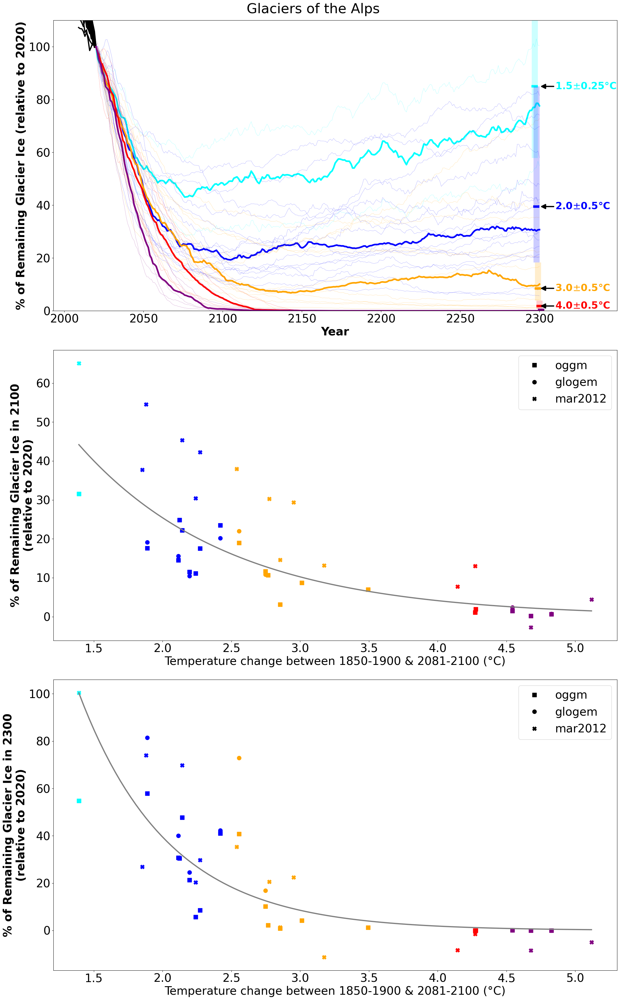

In [691]:
######################
from scipy.optimize import curve_fit

def exponential_decay(x, a, b):
    # avoind overflow -> does not work ... 
    exp_values = -b * x
    #exp_values = np.clip(exp_values, -709, 709)  # Clip values to avoid overflow
    return a * np.exp(exp_values) #+ c * np.exp(-d * x**2)#**c 
param_bounds = ([0, 0], [1000, 5])
pd_exp_decay_fits_simple = pd.DataFrame(index=np.arange(0,20*4,1),
                                        columns=['rgi_reg','year',
                                                 'a', 'b'])
rgi_regs_global = ['global','01', '02', '03', '04', '05', '06', '07',
                   '08', '09', '10', '11', '12', '13', '14', '15',
                   '16', '17', '18', '19']

path_d = {}

path_d['oggm']  = '/home/lilianschuster/oggm-standard-projections-csv-files/1.6.1/common_running_2100_2300/'
path_d['glogem'] = '/home/lilianschuster/glacier-model-standard-projections/GloGEM/'
path_d['mar2012'] = '/home/lilianschuster/glacier-model-standard-projections/Mar2012/'

list_index_l = []
err_l = []
for m in path_d.keys():
    list_index_l.append(list(pd_cmip_temp_ch_2100.index + '_' + m))
pd_proj_2100_2300 = pd.DataFrame(index=np.concatenate(list_index_l))

colors_temp= {'+1.5°C':'cyan', '+2.0°C':'blue', '+3.0°C':'orange', '+4.0°C':'red', '+5.0°C':'purple'}

for jj,_rgi_reg in enumerate([rgi_regs_global[11]]):
    if _rgi_reg !='global':
        rgi_reg = f'RGI{_rgi_reg}'
    else:
        rgi_reg = _rgi_reg 
    fig, axs = plt.subplots(3,1, figsize=(22,35)) #harey=True, sharex=True)
    plt.rc('font', size=28)
    for end_year,ls in zip(['2300'], ['-']):
        for temp_lev in colors_temp.keys():
            df_rel_l = []
            for cmip,pd_cmip in zip(['CMIP5','CMIP6'],
                                    [pd_cmip5_temp_ch_2100, pd_cmip6_temp_ch_2100.loc[pd_cmip6_temp_ch_2100.ssp != 'ssp534-over']]):
                for gcm_scenario in pd_cmip[f'global_temp_ch_level_2081-2100_preindustrial_{temp_lev}'].dropna().index:
                    for m in path_d.keys():
                        try:
                            gcm, scenario = gcm_scenario.split('_')
                            path = path_d[m]
                            n = len(gcm_scenario)
                            gcm_scenario_m = gcm_scenario + '_' + m

                            idir = path  + f'volume/{cmip}/{end_year}/{rgi_reg}/'
                            df = pd.read_csv(idir + f'{scenario}.csv', index_col=0)
                            df.columns = list(map(str.upper, df.columns.values))
                            df = df[gcm.upper()]
                            df_rel = 100*df/df.loc[2020]
                            if end_year =='2100':
                                alpha = 0.5
                            else:
                                alpha = 1
                            axs[0].plot(df.loc[2020:].index, df_rel.loc[2020:], lw=0.2, color=colors_temp[temp_lev],ls=ls, alpha = alpha,
                                   ) #label = label, ls=ls)
                            axs[0].plot(df.loc[2000:2020].index, df_rel.loc[2000:2020], lw=3, color='black',ls=ls, alpha = alpha,
                                   ) #label = label, ls=ls)
                            df_rel_l.append(df_rel)
                            if m == 'oggm':
                                marker = 's'
                            elif m == 'glogem':
                                marker = 'o'
                            elif m == 'mar2012':
                                marker = 'X'
                            pd_proj_2100_2300.loc[gcm_scenario_m, 'global_temp_ch_2081-2100_preindustrial'] = pd_cmip.loc[gcm_scenario, 'global_temp_ch_2081-2100_preindustrial']
                            axs[1].plot([pd_cmip.loc[gcm_scenario, 'global_temp_ch_2081-2100_preindustrial']], [df_rel.loc[2100]], colors_temp[temp_lev], marker=marker, markersize=10)
                            pd_proj_2100_2300.loc[gcm_scenario_m, f'rel_ice_2100_{rgi_reg}'] = df_rel.loc[2100]    

                            axs[2].plot([pd_cmip.loc[gcm_scenario, 'global_temp_ch_2081-2100_preindustrial']], [df_rel.loc[2300]], colors_temp[temp_lev], marker=marker, markersize=10)
                            pd_proj_2100_2300.loc[gcm_scenario_m, f'rel_ice_2300_{rgi_reg}'] = df_rel.loc[2300]    
                            
                        except:
                            err_l.append([gcm_scenario,m,cmip,temp_lev,end_year, rgi_reg])
                            pass
            if len(df_rel_l) > 0:
                df_rel_med = pd.DataFrame(df_rel_l).T.median(axis=1)
                if temp_lev == '+1.5°C':
                    bound = 0.25
                else:
                    bound = 0.50
                #label = f'{temp_lev}\n'+r'$\pm$'+f'{bound}°C' #' (n={len(df_rel_l)}), in reality: {temp_lev_reality[temp_lev]}'
                axs[0].plot(df_rel_med.loc[2020:2300].index, df_rel_med.loc[2020:2300], lw=4, color=colors_temp[temp_lev],
                            #label = label,
                            ls=ls)
                df_rel_q25 = pd.DataFrame(df_rel_l).T.quantile(0.25, axis=1).loc[2020:2300]
                df_rel_q75 = pd.DataFrame(df_rel_l).T.quantile(0.75, axis=1).loc[2020:2300]
                
                #axs[0].fill_between(df_rel_med.loc[2020:2300].index, df_rel_q25, df_rel_q75, lw=0.5, alpha=0.2, 
                #                    color=colors_temp[temp_lev],
                #                         ls = ls)
        axs[0].set_ylim([0,110])
        axs[0].set_ylabel('% of Remaining Glacier Ice (relative to 2020)',  fontweight = 'bold')
        axs[0].set_xlabel('Year',  fontweight = 'bold')
        handles, labels = axs[0].get_legend_handles_labels()
        for h in handles:
            h.set_linewidth(3)
        axs[0].legend(handles, labels,
                      handlelength=1,
                      title='Temperature change between 1850-1900 & 2081-2100:', ncol=5)
        axs[0].legend().remove()
        axs[1].set_ylabel('% of Remaining Glacier Ice in 2100\n(relative to 2020)',  fontweight = 'bold')
        axs[2].set_ylabel('% of Remaining Glacier Ice in 2300\n(relative to 2020)',  fontweight = 'bold')
        
        from matplotlib.lines import Line2D
        
        points = []
        for m in path_d.keys():
            if m == 'oggm':
                marker = 's'
            elif m == 'glogem':
                marker = 'o'
            elif m == 'mar2012':
                marker = 'X'
            points.append(Line2D([0], [0], label=m, marker=marker, markersize=10, 
            markeredgecolor='k', markerfacecolor='k', linestyle=''))
        axs[1].legend(handles=points)
        axs[2].legend(handles=points)
        plt.suptitle(d_reg_num_name_icci[_rgi_reg])

        for j,sim_year in enumerate([2100, 2300]):
            # Perform the curve fitting
            pd_proj_x = pd_proj_2100_2300[['global_temp_ch_2081-2100_preindustrial', f'rel_ice_{sim_year}_{rgi_reg}']].dropna()
            x = pd_proj_x['global_temp_ch_2081-2100_preindustrial']
            popt, pcov = curve_fit(exponential_decay, x,
                                   pd_proj_x[f'rel_ice_{sim_year}_{rgi_reg}'],
                                   loss='soft_l1', f_scale=0.1, bounds = param_bounds)  # Lower and upper bounds for a and b)
            # Generate a higher density x range for plotting the fitted curve
            x_dense = np.linspace(x.min(), x.max(), 100)
            # Extract the optimized parameters
            a_opt, b_opt = popt #c_opt
            y_fitted = exponential_decay(x_dense, a_opt, b_opt)
            axs[j+1].plot(x_dense, y_fitted, color='grey', lw=3)
            pd_exp_decay_fits_simple.iloc[jj] = (rgi_reg,sim_year, a_opt, b_opt)
            if sim_year == 2300:
                for j,temp_lev in enumerate(colors_temp.keys()):
                    fit = exponential_decay(float(temp_lev[1:4]), a_opt, b_opt)

                    if temp_lev == '+1.5°C':
                        bound = 0.25
                    else:
                        bound = 0.5
                    if fit >0.5:
                        axs[0].annotate(temp_lev[1:4]+r'$\pm$'+f'{bound}°C', xy=(2300, fit), xytext=(2310, fit),
                                        verticalalignment="center",
                                        arrowprops=dict(arrowstyle= '-|>', color='black', lw=3), color=colors_temp[temp_lev], alpha=1, fontweight = 'bold', fontsize=24)
                    axs[0].hlines(fit, 2300-3+j*1-2, 2300-3+j*1 +2, lw=6, color=colors_temp[temp_lev])
                    y_fitted = exponential_decay(np.array([float(temp_lev[1:4])-bound, float(temp_lev[1:4])+bound]), a_opt, b_opt)
                    axs[0].vlines(2300-3+j*1,y_fitted[0], y_fitted[1], color=colors_temp[temp_lev], lw=15, alpha = 0.2)

            elif sim_year == 2100:
                for j,temp_lev in enumerate(colors_temp.keys()):
                    if temp_lev == '+1.5°C':
                        bound = 0.25
                    else:
                        bound = 0.5
                    y_fitted = exponential_decay(np.array([float(temp_lev[1:4])-bound, float(temp_lev[1:4])+bound]), a_opt, b_opt)
                    #axs[0].vlines(2100-3+j*1,y_fitted[0], y_fitted[1], color=colors_temp[temp_lev], lw=15, alpha = 0.3)
                    #axs[0].annotate(temp_lev, xy=(2300, fit), xytext=(2310, fit),
                    #                verticalalignment="center",
                    #                arrowprops=dict(arrowstyle= '-|>', color='black', lw=3), color=colors_temp[temp_lev], alpha=1, fontweight = 'bold')
        axs[0].set_xlim([1993, 2349])
        
        for ax in axs[1:]:
            ax.set_xlabel('Temperature change between 1850-1900 & 2081-2100 (°C)')             
    plt.tight_layout()                                  
    plt.savefig(f'exp_fit_{rgi_reg}_2100_2300_oggm_glogem_mar2012.png')

In [679]:
err_l

[['GFDL-ESM2G_rcp45', 'oggm', 'CMIP5', '+1.5°C', '2300', 'RGI08'],
 ['GFDL-ESM2G_rcp45', 'glogem', 'CMIP5', '+1.5°C', '2300', 'RGI08'],
 ['GFDL-ESM2G_rcp45', 'mar2012', 'CMIP5', '+1.5°C', '2300', 'RGI08'],
 ['NORESM1-M_rcp26', 'oggm', 'CMIP5', '+1.5°C', '2300', 'RGI08'],
 ['NORESM1-M_rcp26', 'glogem', 'CMIP5', '+1.5°C', '2300', 'RGI08'],
 ['NORESM1-M_rcp26', 'mar2012', 'CMIP5', '+1.5°C', '2300', 'RGI08'],
 ['MPI-ESM-LR_rcp26', 'glogem', 'CMIP5', '+1.5°C', '2300', 'RGI08'],
 ['CCSM4_rcp26', 'oggm', 'CMIP5', '+1.5°C', '2300', 'RGI08'],
 ['CCSM4_rcp26', 'glogem', 'CMIP5', '+1.5°C', '2300', 'RGI08'],
 ['CCSM4_rcp26', 'mar2012', 'CMIP5', '+1.5°C', '2300', 'RGI08'],
 ['CNRM-CM5_rcp26', 'oggm', 'CMIP5', '+1.5°C', '2300', 'RGI08'],
 ['CNRM-CM5_rcp26', 'glogem', 'CMIP5', '+1.5°C', '2300', 'RGI08'],
 ['CNRM-CM5_rcp26', 'mar2012', 'CMIP5', '+1.5°C', '2300', 'RGI08'],
 ['MPI-ESM1-2-HR_ssp126', 'oggm', 'CMIP6', '+1.5°C', '2300', 'RGI08'],
 ['MPI-ESM1-2-HR_ssp126', 'glogem', 'CMIP6', '+1.5°C', '2300

In [676]:
pd_proj_2100_2300.sort_values(by='global_temp_ch_2081-2100_preindustrial')

,global_temp_ch_2081-2100_preindustrial,rel_ice_2100_RGI08,rel_ice_2300_RGI08
MPI-ESM-LR_rcp26_oggm,1.391439,31.056875,8.232110
MPI-ESM-LR_rcp26_mar2012,1.391439,54.496544,55.154827
GISS-E2-R_rcp45_mar2012,1.852433,47.490147,26.548071
IPSL-CM5A-LR_rcp26_mar2012,1.879291,35.438459,25.807112
MRI-ESM2-0_ssp126_glogem,1.889226,50.121019,218.930051
...,...,...,...
GFDL-CM3_rcp85_mar2012,NaN,NaN,NaN
NORESM1-M_rcp85_mar2012,NaN,NaN,NaN
CCSM4_rcp85_mar2012,NaN,NaN,NaN
GFDL-ESM2G_rcp85_mar2012,NaN,NaN,NaN


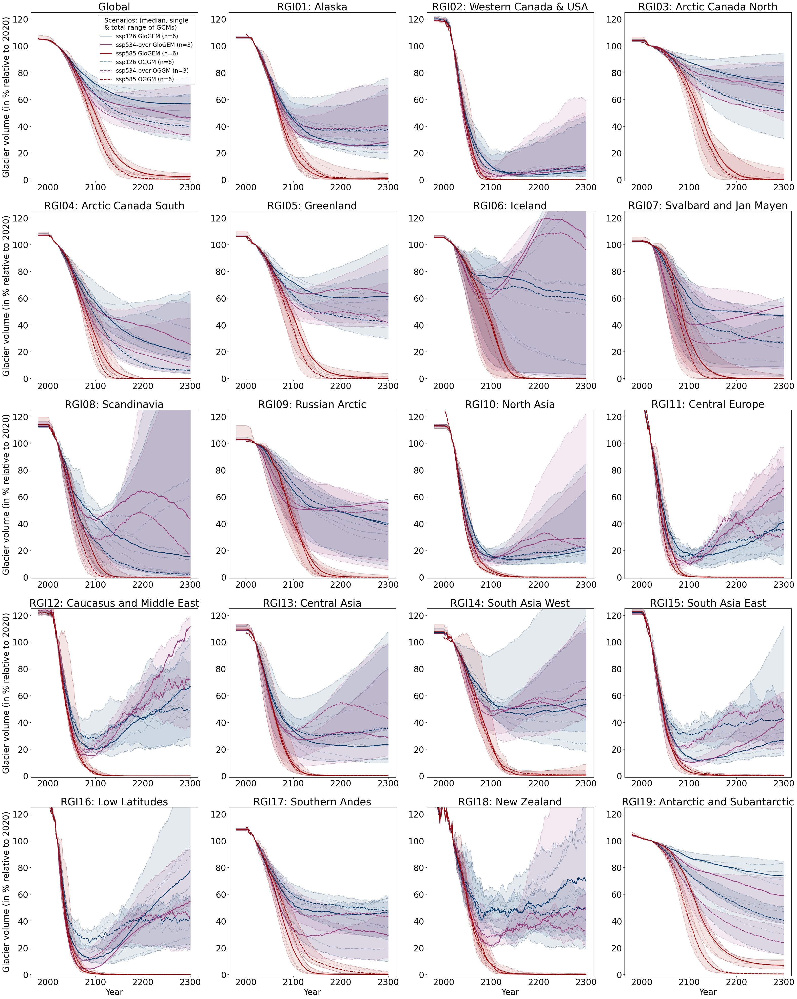

In [344]:
# GloGEM does not have IPSL-CM6A-LR ssp534-over -> let's remove that one from the oGGM ensemble 
path_glogem = '/home/lilianschuster/glacier-model-standard-projections/GloGEM/'

ls_d = {2300:'-'} 
#, 2300:'--'}
cmip = 'CMIP6'
plt.rc('font', size=24)
plt.figure(figsize=(32,40)) #harey=True, sharex=True)
#plt.ylabel('Volume (in % relative to 2020)')

for j,r in enumerate(['Global', 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19]):
    plt.subplot(5,4,j+1)
    ax = plt.gca()

    if r == 'Global':
        rgi_reg = r
        rgi_reg_l = 'global'
        ax.set_title('Global')
    else:
        rgi_reg = f'{r:02}'
        rgi_reg_l = f'RGI{rgi_reg}'
        ax.set_title(f'{rgi_reg_l}: {d_reg_num_name[rgi_reg]}')

    for end_year in [2300]:
        ls = ls_d[end_year]
        # let's only plot those scenarios that exist only until 2300
        scenario_list = list(df_meta.loc[(df_meta.cmip==cmip) & (df_meta.end_year==2300)].scenario.unique())
        scenario_list.sort()
        for scenario in scenario_list:
            idir = path_glogem + f'volume/{cmip}/{end_year}/{rgi_reg_l}/'

            df = pd.read_csv(idir + f'{scenario}.csv', index_col=0)
            df_rel = 100*df/df.loc[2020]

            ax.plot(df.index, df_rel.median(axis=1), lw=2, color=colors_scenario[scenario],
                    label = f'{scenario} GloGEM (n={len(df_rel.columns)})', ls= ls_d[end_year])
            ax.plot(df.index, df_rel, lw=0.5, alpha = 0.5, color=colors_scenario[scenario],
                   ls= ls_d[end_year]);
            ax.fill_between(df.index, df_rel.min(axis=1), df_rel.max(axis=1), alpha=0.1, color=colors_scenario[scenario])
    if j in [0,4,8,12,16]:
        ax.set_ylabel('Glacier volume (in % relative to 2020)')
    if j>=16:
        ax.set_xlabel('Year')
    if j == 0:
        ax.legend(title='Scenarios: (median, single\n& total range of GCMs)', ncol=1, fontsize=16, title_fontsize=18, loc = 'upper right');
    ax.set_ylim([-1,125])
plt.tight_layout()


df_meta = pd.read_csv(f'{path}/common_running_2100_2300/metadata.csv')

ls_d[2300] = '--'
for j,r in enumerate(['Global', 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19]):
    plt.subplot(5,4,j+1)
    ax = plt.gca()

    if r == 'Global':
        rgi_reg = r
        rgi_reg_l = 'global'
        ax.set_title('Global')
    else:
        rgi_reg = f'{r:02}'
        rgi_reg_l = f'RGI{rgi_reg}'
        ax.set_title(f'{rgi_reg_l}: {d_reg_num_name[rgi_reg]}')
        
    for end_year in [2300]:
        ls = ls_d[end_year]
        # let's only plot those scenarios that exist only until 2300
        scenario_list = list(df_meta.loc[(df_meta.cmip==cmip) & (df_meta.end_year==2300)].scenario.unique())
        scenario_list.sort()
        for scenario in scenario_list:
            idir = path + '/common_running_2100_2300/' + f'volume/{cmip}/{end_year}/{rgi_reg_l}/'

            df = pd.read_csv(idir + f'{scenario}.csv', index_col=0)
            df_rel = 100*df/df.loc[2020]
            if scenario == 'ssp534-over':
                df_rel = df_rel.drop(columns='IPSL-CM6A-LR')
            ax.plot(df.index, df_rel.median(axis=1), lw=2, color=colors_scenario[scenario],
                    label = f'{scenario} OGGM (n={len(df_rel.columns)})', ls= ls_d[end_year])
            ax.plot(df.index, df_rel, lw=0.5, alpha = 0.5, color=colors_scenario[scenario],
                   ls= ls_d[end_year]);
            ax.fill_between(df.index, df_rel.min(axis=1), df_rel.max(axis=1), alpha=0.1, color=colors_scenario[scenario])
    if j in [0,4,8,12,16]:
        ax.set_ylabel('Glacier volume (in % relative to 2020)')
    if j>=16:
        ax.set_xlabel('Year')
    if j == 0:
        ax.legend(title='Scenarios: (median, single\n& total range of GCMs)', ncol=1, fontsize=16, title_fontsize=18, loc = 'upper right');
    ax.set_ylim([-1,125])
plt.tight_layout()

plt.savefig('regional_glacier_volume_until2300_cmip6_glogem_oggm.png')

IPSL-CM6A-LR ssp534-over


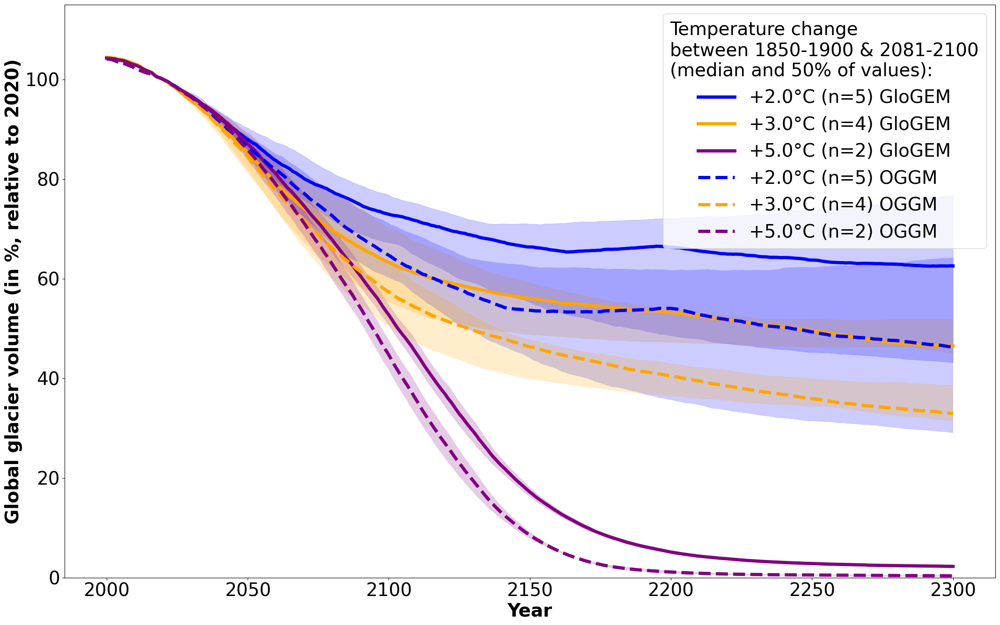

In [345]:
path_glogem = '/home/lilianschuster/glacier-model-standard-projections/GloGEM/'
colors_temp= {'+1.5°C':'cyan', '+2.0°C':'blue', '+3.0°C':'orange', '+4.0°C':'red', '+5.0°C':'purple'}
plt.figure(figsize=(22,14)) #harey=True, sharex=True)

plt.rc('font', size=28)
ax = plt.gca()
for end_year,ls in zip(['2300'], ['-']):
    for temp_lev in colors_temp.keys():
        df_rel_l = []
        # only take those until 2300
        index_2300 = pd_cmip6_temp_ch_2100['global_temp_ch_2281-2300_preindustrial'].dropna().index
        for cmip,pd_cmip in zip(['CMIP6'], [pd_cmip6_temp_ch_2100.loc[index_2300]]):
            for gcm_scenario in pd_cmip[f'global_temp_ch_level_2081-2100_preindustrial_{temp_lev}'].dropna().index:
                try:
                    gcm, scenario = gcm_scenario.split('_')
                    n = len(gcm_scenario)
                    idir = path_glogem + f'volume/{cmip}/{end_year}/global/'
                    df = pd.read_csv(idir + f'{scenario}.csv', index_col=0)
                    df = df.loc[2000:]
                    df.columns = list(map(str.upper, df.columns.values))
                    df = df[gcm.upper()]
                    df_rel = 100*df/df.loc[2020]
                    df_rel_l.append(df_rel)
                except:
                    print(gcm, scenario)
                    pass
        if len(df_rel_l) > 0:
            df_rel_med = pd.DataFrame(df_rel_l).T.median(axis=1)
            label = f'{temp_lev} (n={len(df_rel_l)}) GloGEM'
            ax.plot(df.index, df_rel_med, lw=5, color=colors_temp[temp_lev],
                                label = label, ls=ls)

            df_rel_q0 = pd.DataFrame(df_rel_l).T.quantile(0, axis=1)
            df_rel_q1 = pd.DataFrame(df_rel_l).T.quantile(1, axis=1)
            ax.fill_between(df.index, df_rel_q0, df_rel_q1, lw=0.5, alpha=0.2, 
                                color=colors_temp[temp_lev],
                                    ls = ls)
           
        
            
path_oggm = '/home/lilianschuster/oggm-standard-projections-csv-files/1.6.1'
for end_year,ls in zip(['2300'], ['--']):
    for temp_lev in colors_temp.keys():
        df_rel_l = []

        for cmip,pd_cmip in zip(['CMIP6'], [pd_cmip6_temp_ch_2100]):
            for gcm_scenario in pd_cmip[f'global_temp_ch_level_2081-2100_preindustrial_{temp_lev}'].dropna().index:
                try:
                    gcm, scenario = gcm_scenario.split('_')
                    if (gcm == 'IPSL-CM6A-LR') and (scenario=='ssp534-over'):
                        pass
                    else:
                        n = len(gcm_scenario)
                        idir = path_oggm + '/common_running_2100_2300/' + f'volume/{cmip}/{end_year}/global/'
                        df = pd.read_csv(idir + f'{scenario}.csv', index_col=0)
                        df = df.loc[2000:]
                        df = df[gcm.upper()]
                        df_rel = 100*df/df.loc[2020]
                        df_rel_l.append(df_rel)
                except:
                    pass
        if len(df_rel_l) > 0:
            df_rel_med = pd.DataFrame(df_rel_l).T.median(axis=1)
            label = f'{temp_lev} (n={len(df_rel_l)}) OGGM' #' (n={len(df_rel_l)})'
            ax.plot(df.index, df_rel_med, lw=5, color=colors_temp[temp_lev],
                                label = label, ls='--')

            df_rel_q0 = pd.DataFrame(df_rel_l).T.quantile(0, axis=1)
            df_rel_q1 = pd.DataFrame(df_rel_l).T.quantile(1, axis=1)
            ax.fill_between(df.index, df_rel_q0, df_rel_q1, lw=0.5, alpha=0.2, 
                                color=colors_temp[temp_lev],
                                     ls = ls)
            
plt.ylim([0,115])
plt.ylabel('Global glacier volume (in %, relative to 2020)',  fontweight = 'bold')
plt.xlabel('Year',  fontweight = 'bold')
plt.legend(title='Temperature change\nbetween 1850-1900 & 2081-2100\n(median and 50% of values):', ncol=1)
plt.tight_layout()
plt.savefig('simple_glogem_OGGM_only_cmip6.png')

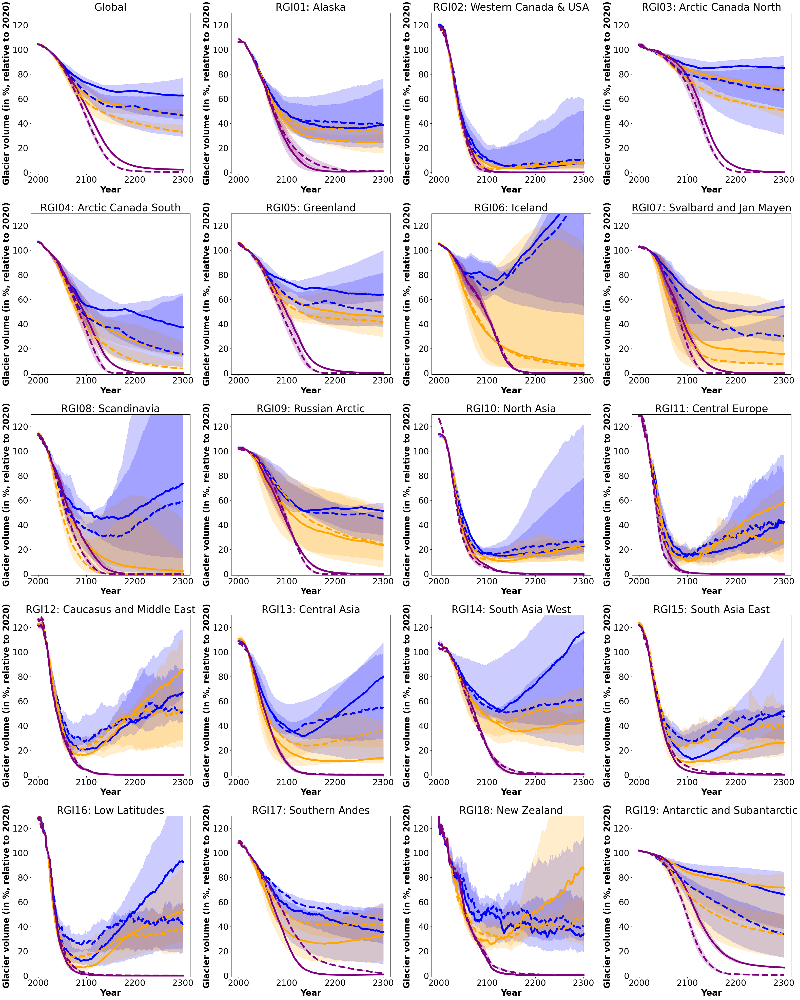

In [346]:
path_glogem = '/home/lilianschuster/glacier-model-standard-projections/GloGEM/'
path_oggm = '/home/lilianschuster/oggm-standard-projections-csv-files/1.6.1'

colors_temp= {'+1.5°C':'cyan', '+2.0°C':'blue', '+3.0°C':'orange', '+4.0°C':'red', '+5.0°C':'purple'}

plt.rc('font', size=24)
plt.figure(figsize=(32,40)) #harey=True, sharex=True)
#plt.ylabel('Volume (in % relative to 2020)')

for j,r in enumerate(['Global', 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19]):
    plt.subplot(5,4,j+1)
    ax = plt.gca()

    if r == 'Global':
        rgi_reg = r
        rgi_reg_l = 'global'
        ax.set_title('Global')
    else:
        rgi_reg = f'{r:02}'
        rgi_reg_l = f'RGI{rgi_reg}'
        ax.set_title(f'{rgi_reg_l}: {d_reg_num_name[rgi_reg]}')

    for end_year,ls in zip(['2300'], ['-']):
        for temp_lev in colors_temp.keys():
            df_rel_l = []
            # only take those until 2300
            index_2300 = pd_cmip6_temp_ch_2100['global_temp_ch_2281-2300_preindustrial'].dropna().index
            for cmip,pd_cmip in zip(['CMIP6'], [pd_cmip6_temp_ch_2100.loc[index_2300]]):
                for gcm_scenario in pd_cmip[f'global_temp_ch_level_2081-2100_preindustrial_{temp_lev}'].dropna().index:
                    try:
                        gcm, scenario = gcm_scenario.split('_')
                        n = len(gcm_scenario)
                        idir = path_glogem + f'volume/{cmip}/{end_year}/{rgi_reg_l}/'
                        df = pd.read_csv(idir + f'{scenario}.csv', index_col=0)
                        df = df.loc[2000:]
                        df.columns = list(map(str.upper, df.columns.values))
                        df = df[gcm.upper()]
                        df_rel = 100*df/df.loc[2020]
                        df_rel_l.append(df_rel)
                    except:
                        #print(gcm, scenario)
                        pass
            if len(df_rel_l) > 0:
                df_rel_med = pd.DataFrame(df_rel_l).T.median(axis=1)
                label = f'{temp_lev} (n={len(df_rel_l)}) GloGEM'
                ax.plot(df.index, df_rel_med, lw=5, color=colors_temp[temp_lev],
                                    label = label, ls=ls)

                df_rel_q0 = pd.DataFrame(df_rel_l).T.quantile(0, axis=1)
                df_rel_q1 = pd.DataFrame(df_rel_l).T.quantile(1, axis=1)
                ax.fill_between(df.index, df_rel_q0, df_rel_q1, lw=0.5, alpha=0.2, 
                                    color=colors_temp[temp_lev],
                                        ls = ls)



    for end_year,ls in zip(['2300'], ['--']):
        for temp_lev in colors_temp.keys():
            df_rel_l = []

            for cmip,pd_cmip in zip(['CMIP6'], [pd_cmip6_temp_ch_2100]):
                for gcm_scenario in pd_cmip[f'global_temp_ch_level_2081-2100_preindustrial_{temp_lev}'].dropna().index:
                    try:
                        gcm, scenario = gcm_scenario.split('_')
                        if (gcm == 'IPSL-CM6A-LR') and (scenario=='ssp534-over'):
                            pass
                        else:
                            n = len(gcm_scenario)
                            idir = path_oggm + '/common_running_2100_2300/' + f'volume/{cmip}/{end_year}/{rgi_reg_l}/'
                            df = pd.read_csv(idir + f'{scenario}.csv', index_col=0)
                            df = df.loc[2000:]
                            df = df[gcm.upper()]
                            df_rel = 100*df/df.loc[2020]
                            df_rel_l.append(df_rel)
                    except:
                        pass
            if len(df_rel_l) > 0:
                df_rel_med = pd.DataFrame(df_rel_l).T.median(axis=1)
                label = f'{temp_lev} (n={len(df_rel_l)}) OGGM' #' (n={len(df_rel_l)})'
                ax.plot(df.index, df_rel_med, lw=5, color=colors_temp[temp_lev],
                                    label = label, ls='--')

                df_rel_q0 = pd.DataFrame(df_rel_l).T.quantile(0, axis=1)
                df_rel_q1 = pd.DataFrame(df_rel_l).T.quantile(1, axis=1)
                ax.fill_between(df.index, df_rel_q0, df_rel_q1, lw=0.5, alpha=0.2, 
                                    color=colors_temp[temp_lev],
                                         ls = ls)

    plt.ylim([-1,130])
    plt.ylabel(f'Glacier volume (in %, relative to 2020)',  fontweight = 'bold')
    plt.xlabel('Year',  fontweight = 'bold')
    #plt.legend(title='Temperature change\nbetween 1850-1900 & 2081-2100\n(median and 50% of values):', ncol=1)
    plt.tight_layout()
    plt.savefig('simple_glogem_OGGM_only_cmip6_regional.png')

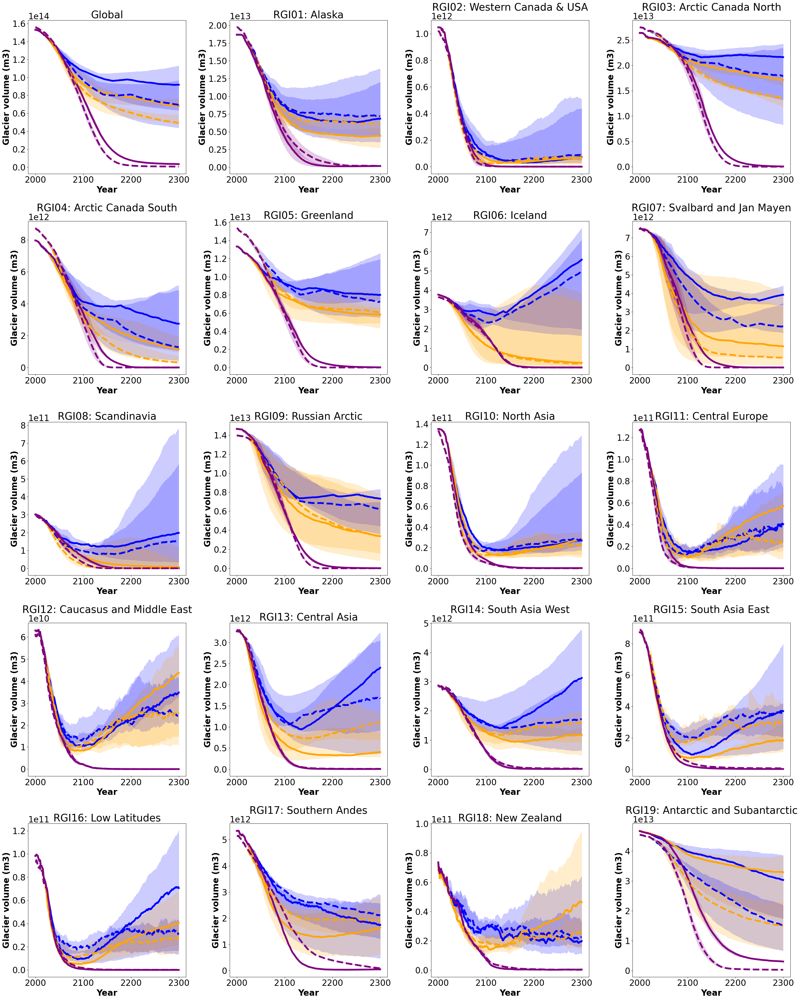

In [347]:
path_glogem = '/home/lilianschuster/glacier-model-standard-projections/GloGEM/'
path_oggm = '/home/lilianschuster/oggm-standard-projections-csv-files/1.6.1'

colors_temp= {'+1.5°C':'cyan', '+2.0°C':'blue', '+3.0°C':'orange', '+4.0°C':'red', '+5.0°C':'purple'}

plt.rc('font', size=24)
plt.figure(figsize=(32,40)) #harey=True, sharex=True)
#plt.ylabel('Volume (in % relative to 2020)')

for j,r in enumerate(['Global', 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19]):
    plt.subplot(5,4,j+1)
    ax = plt.gca()

    if r == 'Global':
        rgi_reg = r
        rgi_reg_l = 'global'
        ax.set_title('Global')
    else:
        rgi_reg = f'{r:02}'
        rgi_reg_l = f'RGI{rgi_reg}'
        ax.set_title(f'{rgi_reg_l}: {d_reg_num_name[rgi_reg]}')

    for end_year,ls in zip(['2300'], ['-']):
        for temp_lev in colors_temp.keys():
            df_rel_l = []
            # only take those until 2300
            index_2300 = pd_cmip6_temp_ch_2100['global_temp_ch_2281-2300_preindustrial'].dropna().index
            for cmip,pd_cmip in zip(['CMIP6'], [pd_cmip6_temp_ch_2100.loc[index_2300]]):
                for gcm_scenario in pd_cmip[f'global_temp_ch_level_2081-2100_preindustrial_{temp_lev}'].dropna().index:
                    try:
                        gcm, scenario = gcm_scenario.split('_')
                        n = len(gcm_scenario)
                        idir = path_glogem + f'volume/{cmip}/{end_year}/{rgi_reg_l}/'
                        df = pd.read_csv(idir + f'{scenario}.csv', index_col=0)
                        df = df.loc[2000:]
                        df.columns = list(map(str.upper, df.columns.values))
                        df = df[gcm.upper()]
                        df_rel = df #100*df/df.loc[2020]
                        df_rel_l.append(df_rel)
                    except:
                        #print(gcm, scenario)
                        pass
            if len(df_rel_l) > 0:
                df_rel_med = pd.DataFrame(df_rel_l).T.median(axis=1)
                label = f'{temp_lev} (n={len(df_rel_l)}) GloGEM'
                ax.plot(df.index, df_rel_med, lw=5, color=colors_temp[temp_lev],
                                    label = label, ls=ls)

                df_rel_q0 = pd.DataFrame(df_rel_l).T.quantile(0, axis=1)
                df_rel_q1 = pd.DataFrame(df_rel_l).T.quantile(1, axis=1)
                ax.fill_between(df.index, df_rel_q0, df_rel_q1, lw=0.5, alpha=0.2, 
                                    color=colors_temp[temp_lev],
                                        ls = ls)



    for end_year,ls in zip(['2300'], ['--']):
        for temp_lev in colors_temp.keys():
            df_rel_l = []

            for cmip,pd_cmip in zip(['CMIP6'], [pd_cmip6_temp_ch_2100]):
                for gcm_scenario in pd_cmip[f'global_temp_ch_level_2081-2100_preindustrial_{temp_lev}'].dropna().index:
                    try:
                        gcm, scenario = gcm_scenario.split('_')
                        if (gcm == 'IPSL-CM6A-LR') and (scenario=='ssp534-over'):
                            pass
                        else:
                            n = len(gcm_scenario)
                            idir = path_oggm + '/common_running_2100_2300/' + f'volume/{cmip}/{end_year}/{rgi_reg_l}/'
                            df = pd.read_csv(idir + f'{scenario}.csv', index_col=0)
                            df = df.loc[2000:]
                            df = df[gcm.upper()]
                            df_rel = df #100*df/df.loc[2020]
                            df_rel_l.append(df_rel)
                    except:
                        pass
            if len(df_rel_l) > 0:
                df_rel_med = pd.DataFrame(df_rel_l).T.median(axis=1)
                label = f'{temp_lev} (n={len(df_rel_l)}) OGGM' #' (n={len(df_rel_l)})'
                ax.plot(df.index, df_rel_med, lw=5, color=colors_temp[temp_lev],
                                    label = label, ls='--')

                df_rel_q0 = pd.DataFrame(df_rel_l).T.quantile(0, axis=1)
                df_rel_q1 = pd.DataFrame(df_rel_l).T.quantile(1, axis=1)
                ax.fill_between(df.index, df_rel_q0, df_rel_q1, lw=0.5, alpha=0.2, 
                                    color=colors_temp[temp_lev],
                                         ls = ls)

    #plt.ylim([-1,130])
    plt.ylabel(f'Glacier volume (m3)',  fontweight = 'bold')
    plt.xlabel('Year',  fontweight = 'bold')
    #plt.legend(title='Temperature change\nbetween 1850-1900 & 2081-2100\n(median and 50% of values):', ncol=1)
    plt.tight_layout()
    plt.savefig('simple_glogem_OGGM_only_cmip6_regional_absolute.png')

In [ ]:
plt.rc('font', size=24)
end_year= 2100
ls_d = {2100:'-', 2300:'--'}
plt.figure(figsize=(32,12)) #harey=True, sharex=True)
for j,cmip in enumerate(['CMIP6']):
    ax = plt.gca()
    for end_year in [2100,2300]:
        ls = ls_d[end_year]
        # let's only plot those scenarios that exist only until 2300
        scenario_list = list(df_meta.loc[(df_meta.cmip==cmip) & (df_meta.end_year==2300)].scenario.unique())
        scenario_list.sort()
        for scenario in scenario_list:
            idir = path + 'common_running_2100_2300/' + f'volume/{cmip}/{end_year}/global/'

            df = pd.read_csv(idir + f'{scenario}.csv', index_col=0)
            df_rel = 100*df/df.loc[2020]

            ax.plot(df.index, df_rel.median(axis=1), lw=2, color=colors_scenario[scenario],
                    label = f'{scenario} until {end_year} (n={len(df_rel.columns)})', ls= ls_d[end_year])
            ax.plot(df.index, df_rel, lw=0.8, alpha = 0.5, color=colors_scenario[scenario],
                   ls= ls_d[end_year]);
            ax.fill_between(df.index, df_rel.min(axis=1), df_rel.max(axis=1), alpha=0.1, color=colors_scenario[scenario])

            ax.set_ylabel('Global glacier volume (in % relative to 2020)')
            ax.set_xlabel('Year')
            if end_year == 2300:
                df_rel_2300.loc[f'{cmip}\n{scenario}:\nn={len(df_rel.columns)}', df_rel.columns] = df_rel.loc[2299]
        #if end_year == 2100:
    plt.legend(title='Scenarios: (median of GCMs, total range and single GCMs shown)', ncol=2);

    ax.set_title(cmip)
    plt.savefig('global_glacier_volume_until2300_common_running_2100_2300_cmip6.png')

In [36]:
df_meta

,Unnamed: 0,cmip,gcm_original,gcm,scenario,rgi_reg,end_year,bias_correction,perc_area_missing,fpath,exp,historical_future_option,oggm_version
0,ISIMIP3b_CMIP6:2100:MRI-ESM2-0:ssp585:RGI11,ISIMIP3b_CMIP6,mri-esm2-0,MRI-ESM2-0,ssp585,RGI11,2100,ISIMIP3b:1979-2014,0.000495,/home/www/oggm/oggm-standard-projections/oggm_...,match_geod_pergla,w5e5_gcm_merged,oggm_v1.6.1_2023.3
1,ISIMIP3b_CMIP6:2100:UKESM1-0-LL:ssp585:RGI11,ISIMIP3b_CMIP6,ukesm1-0-ll,UKESM1-0-LL,ssp585,RGI11,2100,ISIMIP3b:1979-2014,0.000495,/home/www/oggm/oggm-standard-projections/oggm_...,match_geod_pergla,w5e5_gcm_merged,oggm_v1.6.1_2023.3
2,ISIMIP3b_CMIP6:2100:MRI-ESM2-0:ssp126:RGI11,ISIMIP3b_CMIP6,mri-esm2-0,MRI-ESM2-0,ssp126,RGI11,2100,ISIMIP3b:1979-2014,0.000495,/home/www/oggm/oggm-standard-projections/oggm_...,match_geod_pergla,w5e5_gcm_merged,oggm_v1.6.1_2023.3
3,ISIMIP3b_CMIP6:2100:UKESM1-0-LL:ssp370:RGI11,ISIMIP3b_CMIP6,ukesm1-0-ll,UKESM1-0-LL,ssp370,RGI11,2100,ISIMIP3b:1979-2014,0.000495,/home/www/oggm/oggm-standard-projections/oggm_...,match_geod_pergla,w5e5_gcm_merged,oggm_v1.6.1_2023.3
4,ISIMIP3b_CMIP6:2100:MRI-ESM2-0:ssp370:RGI11,ISIMIP3b_CMIP6,mri-esm2-0,MRI-ESM2-0,ssp370,RGI11,2100,ISIMIP3b:1979-2014,0.000495,/home/www/oggm/oggm-standard-projections/oggm_...,match_geod_pergla,w5e5_gcm_merged,oggm_v1.6.1_2023.3
...,...,...,...,...,...,...,...,...,...,...,...,...,...
2959,CMIP5:2300:MPI-ESM-LR:rcp26:RGI07,CMIP5,MPI-ESM-LR,MPI-ESM-LR,rcp26,RGI07,2300,2000-2019,0.000000,/home/www/oggm/oggm-standard-projections/oggm_...,match_geod_pergla,w5e5_gcm_merged,oggm_v1.6.1_2023.3
2960,CMIP5:2300:MPI-ESM-LR:rcp45:RGI07,CMIP5,MPI-ESM-LR,MPI-ESM-LR,rcp45,RGI07,2300,2000-2019,0.000000,/home/www/oggm/oggm-standard-projections/oggm_...,match_geod_pergla,w5e5_gcm_merged,oggm_v1.6.1_2023.3
2961,CMIP5:2300:CCSM4:rcp60:RGI07,CMIP5,CCSM4,CCSM4,rcp60,RGI07,2300,2000-2019,0.000000,/home/www/oggm/oggm-standard-projections/oggm_...,match_geod_pergla,w5e5_gcm_merged,oggm_v1.6.1_2023.3
2962,CMIP5:2300:MPI-ESM-LR:rcp85:RGI07,CMIP5,MPI-ESM-LR,MPI-ESM-LR,rcp85,RGI07,2300,2000-2019,0.000000,/home/www/oggm/oggm-standard-projections/oggm_...,match_geod_pergla,w5e5_gcm_merged,oggm_v1.6.1_2023.3


**What next?**

- if you are interested in a comparison to Rounce et al. (2023), you can check out [this jupyter notebook](https://nbviewer.org/urls/cluster.klima.uni-bremen.de/~oggm/oggm-standard-projections/oggm-standard-projections-csv-files/notebooks/compare_oggm_1.6.1_to_rounce_et_al_2023.ipynb?flush_cache=true) where we compared explicitly the common running glaciers
- some example analysis of the raw oggm per-glacier files (together with for example runoff analysis) is in [this notebook](https://nbviewer.org/urls/cluster.klima.uni-bremen.de/~oggm/oggm-standard-projections/analysis_notebooks/workflow_to_analyse_per_glacier_projection_files.ipynb?flush_cache=true)